<a href="https://colab.research.google.com/github/LeoTU911/SCC413/blob/main/convVAE_5_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Wed Mar  1 00:28:48 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    23W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!git clone https://github.com/LeoTU911/SCC413

Cloning into 'SCC413'...
remote: Enumerating objects: 773, done.
remote: Counting objects: 100% (41/41), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 773 (delta 14), reused 11 (delta 3), pack-reused 732
Receiving objects: 100% (773/773), 118.10 MiB | 16.13 MiB/s, done.
Resolving deltas: 100% (116/116), done.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#!rm -rf /content/SCC413
#!ls -R
#!rm -rf /content/SCC413/Keras_convVAE_dataset/generate/generated/*

In [ ]:
import os
import tensorflow as tf
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import keras
import cv2
from keras import backend as K
from keras import losses
from keras.layers import Input, Dense, Lambda, Flatten, Reshape
from keras.layers import Conv2D, Conv2DTranspose, Cropping2D, Dropout
from keras.models import Model
from tensorflow.keras.layers import BatchNormalization, Concatenate, MaxPooling2D, Activation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from PIL import Image

In [ ]:
def imageGeneration1(image, image_path, image_name, iterations):
  image_horizontal = cv2.flip(image, 1)
  names = image_name.split('.')
  fileName = names[0] + '_horizontal' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_horizontal)

def imageGeneration2(image, image_path, image_name, iterations):
  image_vertical = cv2.flip(image, -1)
  names = image_name.split('.')
  fileName = names[0] + '_vertical' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_vertical)

def imageGeneration3(image, image_path, image_name, iterations):
  image_HorVer_tmp = cv2.flip(image, 1)
  image_HorVer = cv2.flip(image_HorVer_tmp, -1)
  names = image_name.split('.')
  fileName = names[0] + '_HorVer' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_HorVer)

def imageGeneration4(image, image_path, image_name, iterations):
  image_VerHor_tmp = cv2.flip(image, -1)
  image_VerHor = cv2.flip(image_VerHor_tmp, 1)
  names = image_name.split('.')
  fileName = names[0] + '_VerHor' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_VerHor)

def imageGeneration5(image, image_path, image_name, iterations):
  image_rotate1 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
  names = image_name.split('.')
  fileName = names[0] + '_rotate1' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_rotate1) 

def imageGeneration6(image, image_path, image_name, iterations):
  image_rotate2 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
  names = image_name.split('.')
  fileName = names[0] + '_rotate2' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_rotate2)

def imageGenerationMain(filePath, n_imgGenerate):
  fileNames = list(os.listdir(filePath))
  for i in range(n_imgGenerate):
    for j in range(len(fileNames)):
      fileName = fileNames[j]
      image = cv2.imread(os.path.join(filePath, fileName))
      imageGeneration1(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration2(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration3(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration4(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration5(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration6(image, image_path = filePath, image_name = fileName, iterations = i)
    print('Image generated, times: ', i+1)
  return True

In [ ]:
filePath1 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_photos'
filePath2 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_sketches'
# every generation will create 6*N photos
# for example, N = 88, 4 loops will create 4*6*88+88(origin) = 2200 images
n_imgGenerate = 1

imageGenerationMain(filePath1, n_imgGenerate)

Image generated, times:  1


True

In [ ]:
imageGenerationMain(filePath2, n_imgGenerate)

Image generated, times:  1


True

In [ ]:
print(len(os.listdir(filePath1)))
print(len(os.listdir(filePath2)))

616
616


In [ ]:
#image to grayscale image
filePath1 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_photos'
filePath2 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_sketches'
filePath3 = '/content/SCC413/Keras_convVAE_dataset/CUHK_testing_cropped_photos'


def img2GSimg(filePath):
  images = []

  for fileName in os.listdir(filePath):
    if fileName.endswith('.jpg'):
      img_tmp = Image.open(os.path.join(filePath, fileName))
      img_tmp = img_tmp.resize((128, 128))
      img_array = np.array(img_tmp)
      images.append(img_array)
  return images

def grayImg2Data(filePath):
  images = []
  for fileName in os.listdir(filePath):
    image_gray = cv2.imread(os.path.join(filePath, fileName), 0)
    image_rgb = cv2.cvtColor(image_gray, cv2.COLOR_GRAY2BGR)
    image_rgb_tmp = cv2.resize(image_rgb, (128, 128))
    img_array = np.array(image_rgb_tmp)
    images.append(img_array)
  return images

images  = img2GSimg(filePath1)
images2 = grayImg2Data(filePath2)
images3 = img2GSimg(filePath3)

x_train = np.array(images).reshape((-1, 128, 128, 3)).astype('float32') / 255.
y_train = np.array(images2).reshape((-1, 128, 128, 3)).astype('float32') / 255.
x_test = np.array(images3).reshape((-1, 128, 128, 3)).astype('float32') / 255.

In [ ]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)

(616, 128, 128, 3)
(616, 128, 128, 3)
(100, 128, 128, 3)


In [ ]:
input_shape = (128, 128, 3)
batch_size = 64
latent_dim = 256
encoder_layers = [64, 128, 256, 512]
decoder_layers = [64, 128, 128, 256, 256, 512, 512]

def sampling(args):
    z_mean, z_log_sigma = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], latent_dim),
                              mean=0., stddev=0.1)
    return z_mean + K.exp(z_log_sigma) * epsilon

# 编码器
inputs = Input(shape=input_shape)
x = inputs
for filters in encoder_layers:
    x = Conv2D(filters, kernel_size=3, strides=2, activation='LeakyReLU', padding='same')(x)
    x = BatchNormalization(axis=1)(x)
    x = MaxPooling2D(padding='same')(x)
shape_before_flattening = x.shape[1:]
x = Flatten()(x)
x = Dense(latent_dim, activation='LeakyReLU')(x)

z_mean = Dense(latent_dim, name='z_mean')(x)
z_log_var = Dense(latent_dim, name='z_log_var')(x)
z = Lambda(sampling, output_shape=(latent_dim,), name='z')([z_mean, z_log_var])

encoder = Model(inputs, [z_mean, z_log_var], name='encoder')

# 解码器
latent_inputs = Input(shape=(latent_dim,), name='z_sampling')
x = Dense(np.prod(shape_before_flattening))(latent_inputs)
x = Reshape(shape_before_flattening)(x)
for filters in decoder_layers:
    x = Conv2DTranspose(filters, kernel_size=3, strides=(2,2), activation='LeakyReLU', padding='same')(x)
x = Conv2DTranspose(3, kernel_size=3, activation='sigmoid', padding='same')(x)
decoder = Model(latent_inputs, x, name='decoder')

encoder.summary()
decoder.summary()

# VAE模型
reconstruction = decoder(z)
vae = Model(inputs, reconstruction, name='vae')

# 计算损失函数
reconstruction_loss = K.mean(K.binary_crossentropy(K.flatten(inputs), K.flatten(reconstruction)))
reconstruction_loss *= input_shape[0] * input_shape[1]
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconstruction_loss + kl_loss)
vae.add_loss(vae_loss)

# 编译模型
vae.compile(optimizer='adam')

Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 64, 64, 64)   1792        ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 64, 64, 64)  256         ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                            

In [ ]:
from keras.models import load_model

model_Path = '/content/drive/MyDrive/model_79.h5'
preTrained_VAE = load_model(model_Path)

# 编译模型
preTrained_VAE.compile(optimizer='adam')

Epoch 1/10
9/9 [==============================] - 55s 3s/step - loss: 11375.1084 - val_loss: 11190.2324
Epoch 2/10
9/9 [==============================] - 15s 2s/step - loss: 11083.6992 - val_loss: 10836.5400
Epoch 3/10
9/9 [==============================] - 15s 2s/step - loss: 10637.1172 - val_loss: 10610.8223
Epoch 4/10
9/9 [==============================] - 15s 2s/step - loss: 10397.5732 - val_loss: 10345.2207
Epoch 5/10
9/9 [==============================] - 15s 2s/step - loss: 10120.0967 - val_loss: 10314.2754
Epoch 6/10
9/9 [==============================] - 15s 2s/step - loss: 10043.1699 - val_loss: 10424.8691
Epoch 7/10
9/9 [==============================] - 15s 2s/step - loss: 10014.9893 - val_loss: 10448.9775
Epoch 8/10
9/9 [==============================] - 15s 2s/step - loss: 9974.3779 - val_loss: 11049.4082
Epoch 9/10
9/9 [==============================] - 15s 2s/step - loss: 9903.8848 - val_loss: 10533.6689
Epoch 10/10
9/9 [==============================] - 15s 2s/step - l

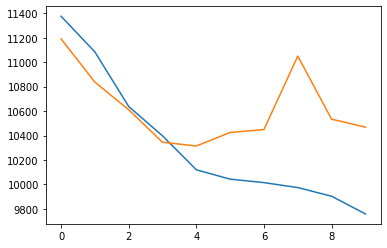

In [ ]:
# 训练模型
checkPointSavedModelName = 'model_{epoch:02d}.h5'
checkPoint = ModelCheckpoint(
    filepath=checkPointSavedModelName,
    monitor='val_loss', 
    save_best_only=True)

vae.fit(x_train, 
    y_train,
    epochs=10,
    batch_size=batch_size,
    shuffle=False,
    validation_split=0.1,
    callbacks=[checkPoint]
    )

# plot
plt.plot(vae.history.history["loss"])
plt.plot(vae.history.history["val_loss"])

# pre-Trained Model continue training
#preTrained_VAE.fit(x_train, 
#    y_train,
#    epochs=100,
#    batch_size=batch_size,
#    shuffle=False,
#    validation_split=0.1,
#    callbacks=[checkPoint]
#    )

# plot
#plt.plot(preTrained_VAE.history.history["loss"])
#plt.plot(preTrained_VAE.history.history["val_loss"])

In [ ]:
# save model
vae.save('vae_model_4.0_Latent_Dim128_Epochs50')

In [ ]:
cp -r /content/vae_model_4.0_Latent_Dim128_Epochs50/ /content/drive/MyDrive/

In [ ]:
#mv /content/model_47.h5 /content/model_47_Latent_Dim128_Epochs50.h5
cp /content/model_47.h5 /content/drive/MyDrive

NameError: ignored

In [31]:
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error

def imgPredictionEvaluate(realImg_array, predictImg_array):

  mse_2img = mean_squared_error(realImg_array, predictImg_array)
  ssim_val_2img = ssim(realImg_array, predictImg_array, multichannel=True)

  evaluations = [round(mse_2img, 4), round(ssim_val_2img, 4)]
  return evaluations

1/1 [==============================] - 0s 347ms/step


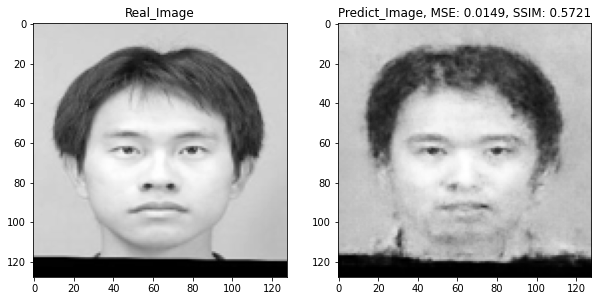

1/1 [==============================] - 0s 22ms/step


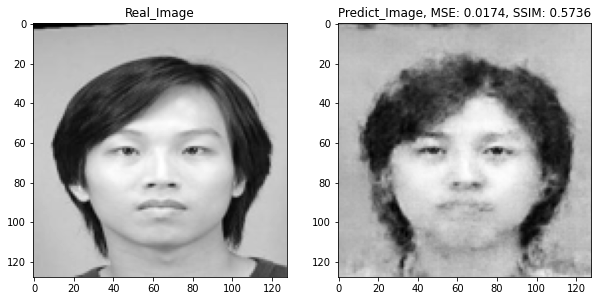

1/1 [==============================] - 0s 20ms/step


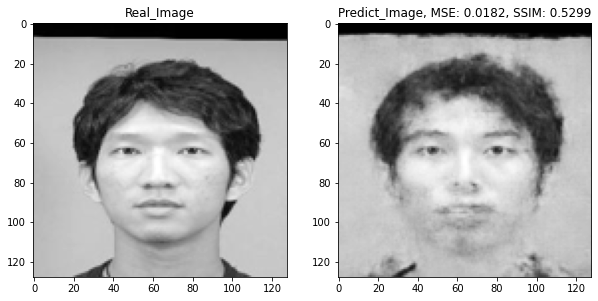

1/1 [==============================] - 0s 21ms/step


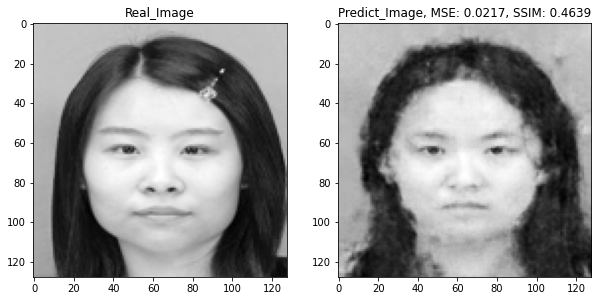

1/1 [==============================] - 0s 22ms/step


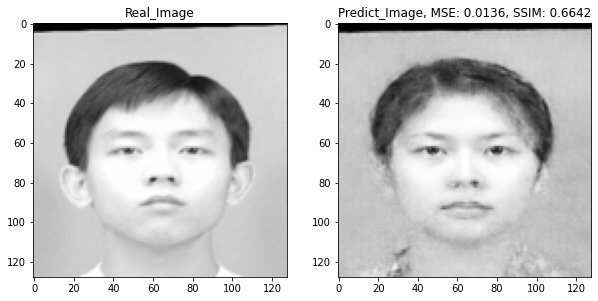

1/1 [==============================] - 0s 21ms/step


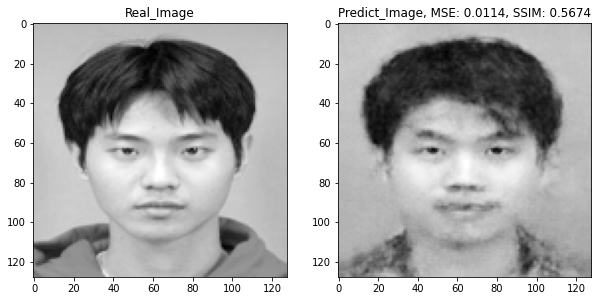

1/1 [==============================] - 0s 20ms/step


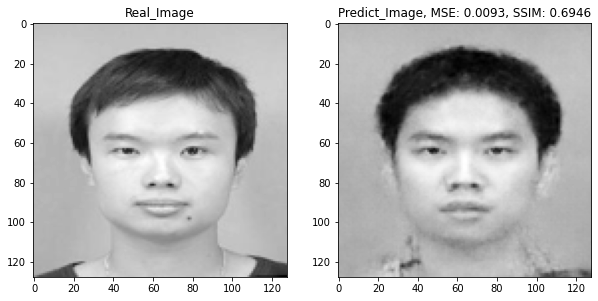

1/1 [==============================] - 0s 20ms/step


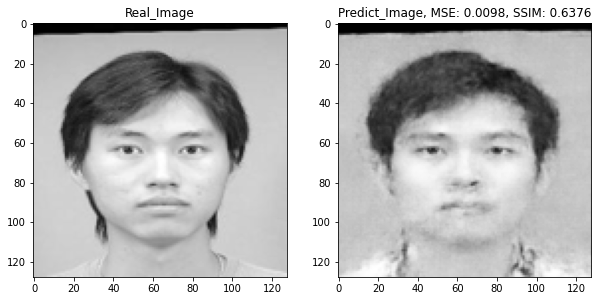

1/1 [==============================] - 0s 22ms/step


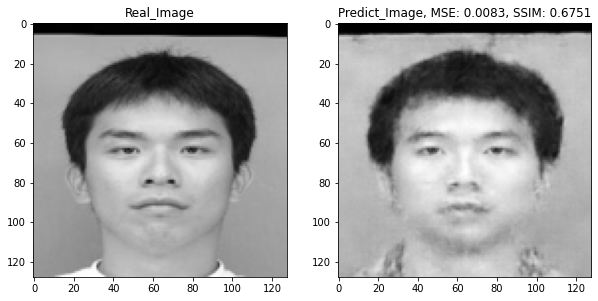

1/1 [==============================] - 0s 21ms/step


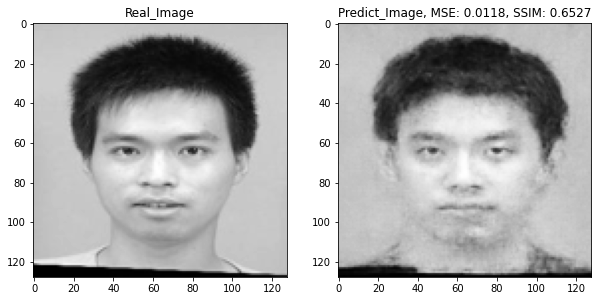

1/1 [==============================] - 0s 22ms/step


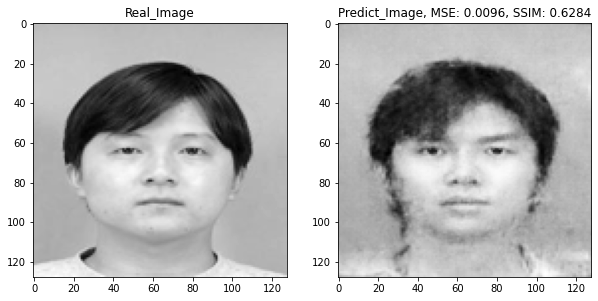

1/1 [==============================] - 0s 21ms/step


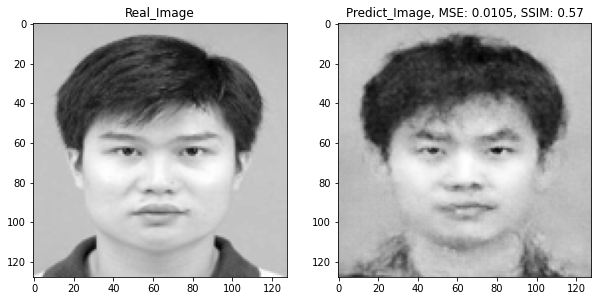

1/1 [==============================] - 0s 21ms/step


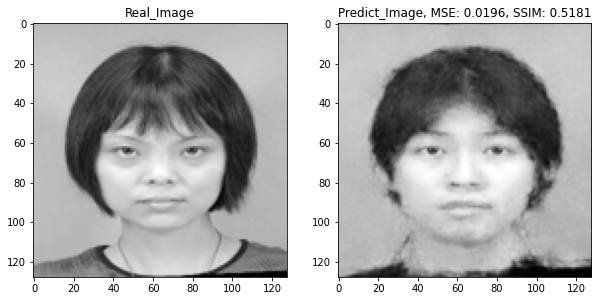

1/1 [==============================] - 0s 20ms/step


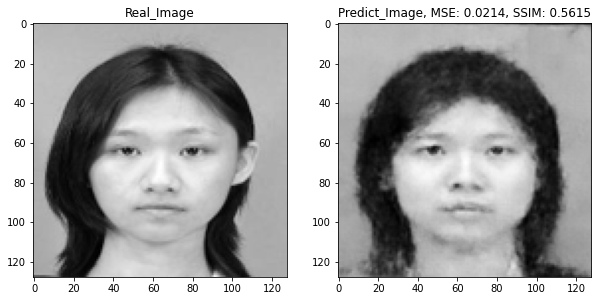

1/1 [==============================] - 0s 21ms/step


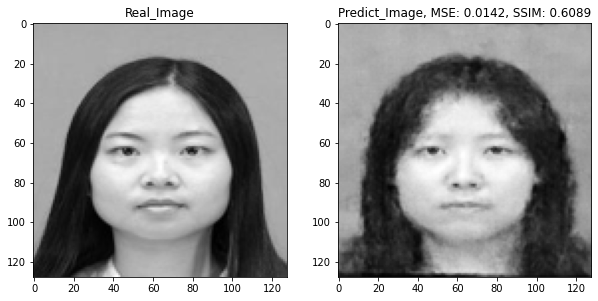

1/1 [==============================] - 0s 23ms/step


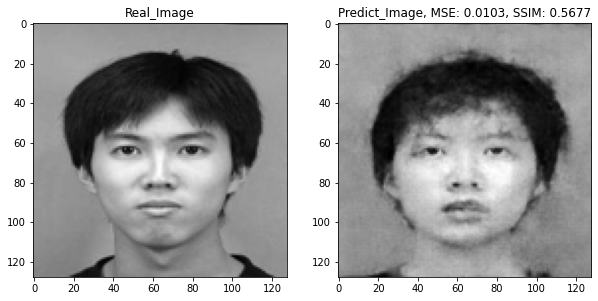

1/1 [==============================] - 0s 23ms/step


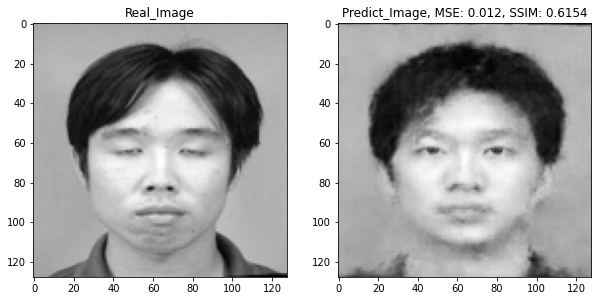

1/1 [==============================] - 0s 21ms/step


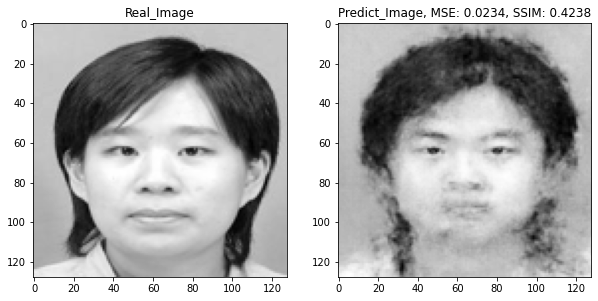

1/1 [==============================] - 0s 21ms/step


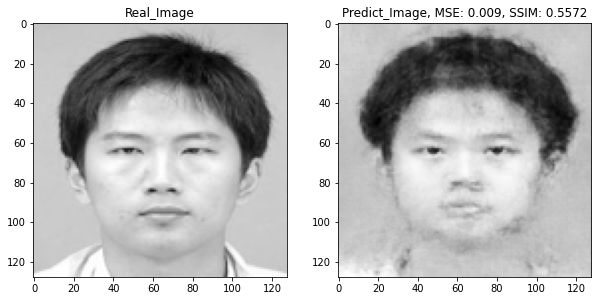

1/1 [==============================] - 0s 21ms/step


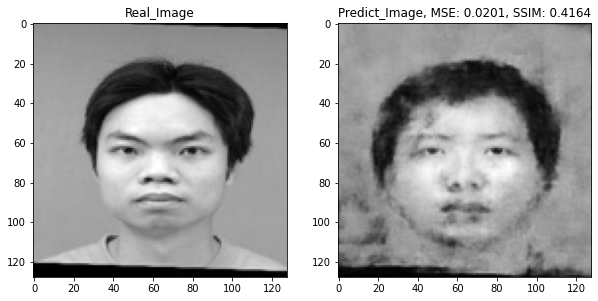

1/1 [==============================] - 0s 21ms/step


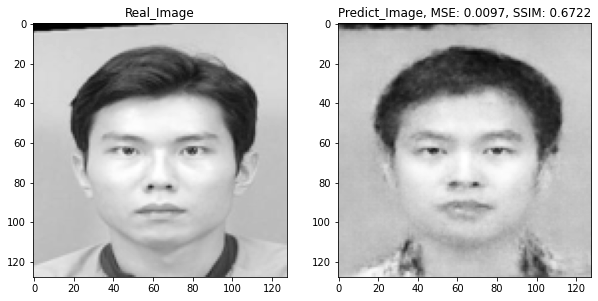

1/1 [==============================] - 0s 22ms/step


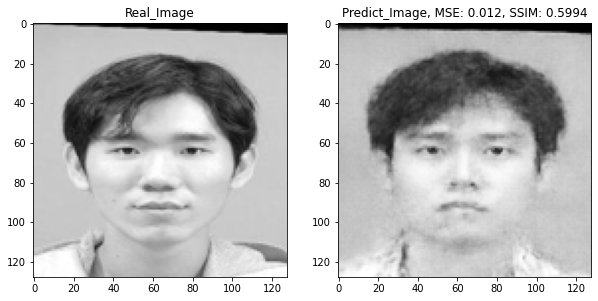

1/1 [==============================] - 0s 21ms/step


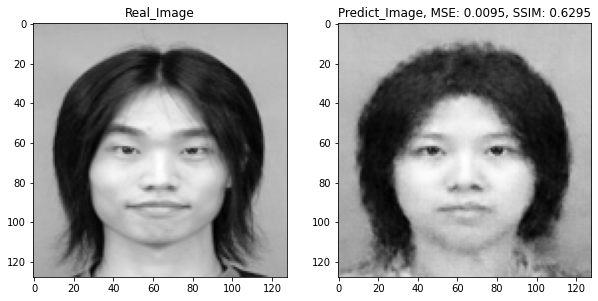

1/1 [==============================] - 0s 20ms/step


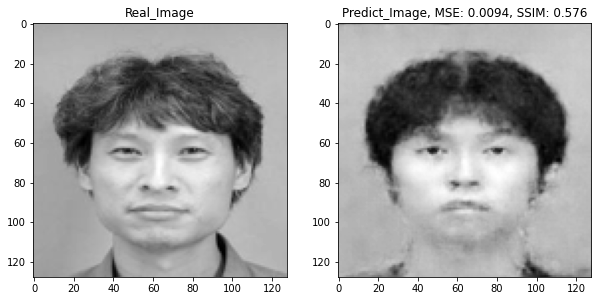

1/1 [==============================] - 0s 20ms/step


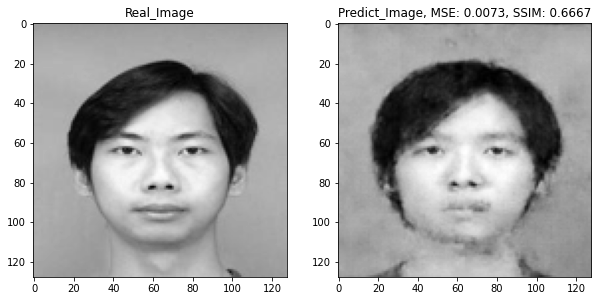

1/1 [==============================] - 0s 20ms/step


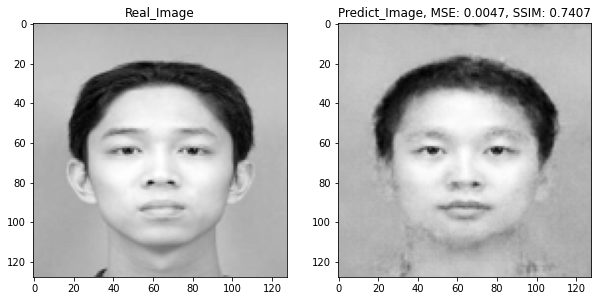

1/1 [==============================] - 0s 20ms/step


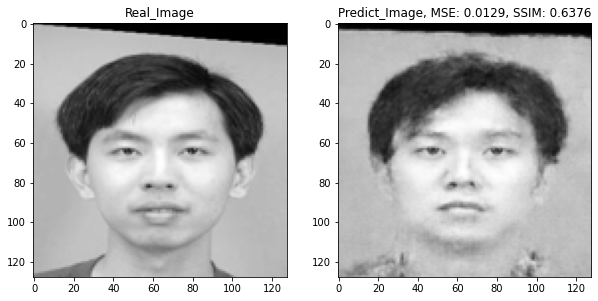

1/1 [==============================] - 0s 20ms/step


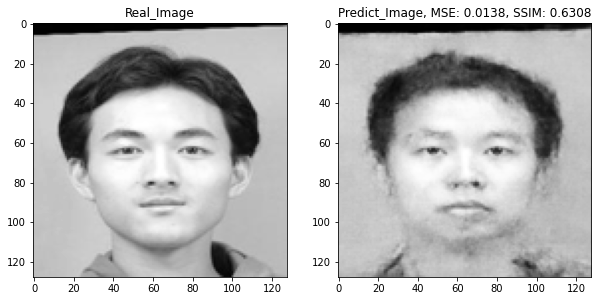

1/1 [==============================] - 0s 20ms/step


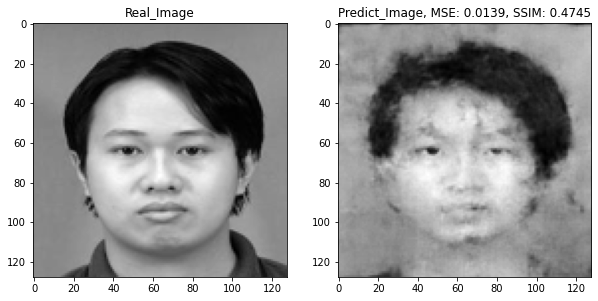

1/1 [==============================] - 0s 20ms/step


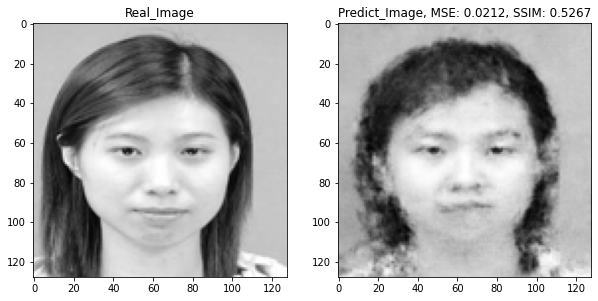

1/1 [==============================] - 0s 21ms/step


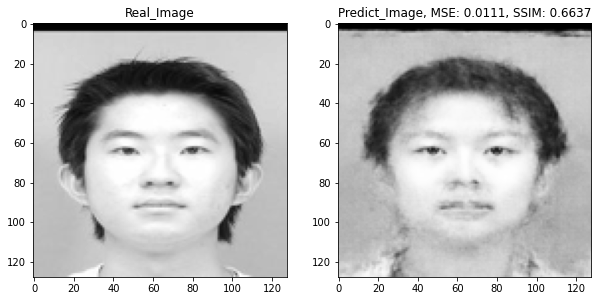

1/1 [==============================] - 0s 20ms/step


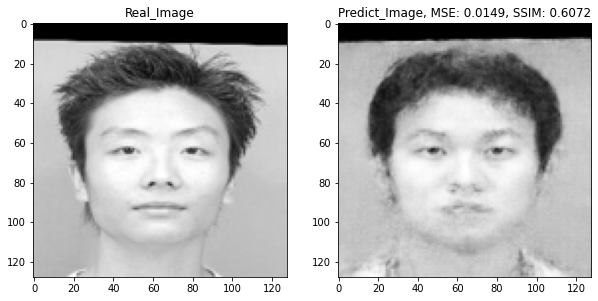

1/1 [==============================] - 0s 21ms/step


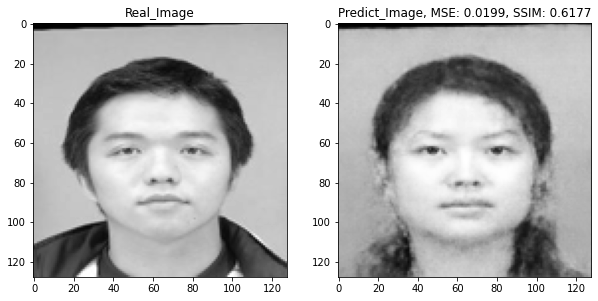

1/1 [==============================] - 0s 21ms/step


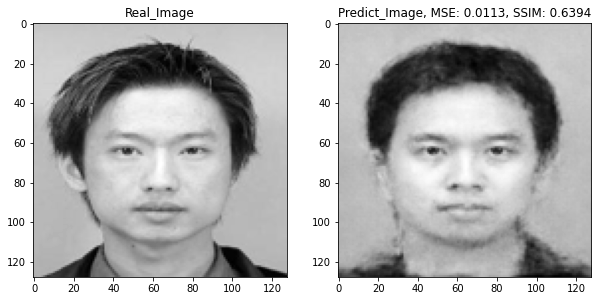

1/1 [==============================] - 0s 21ms/step


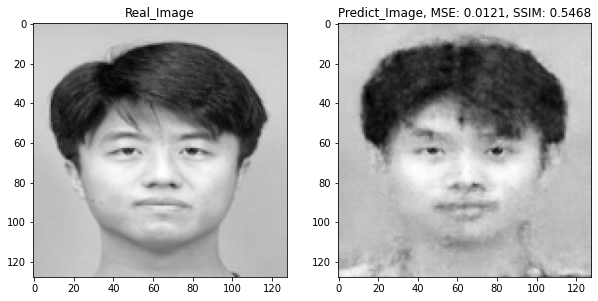

1/1 [==============================] - 0s 20ms/step


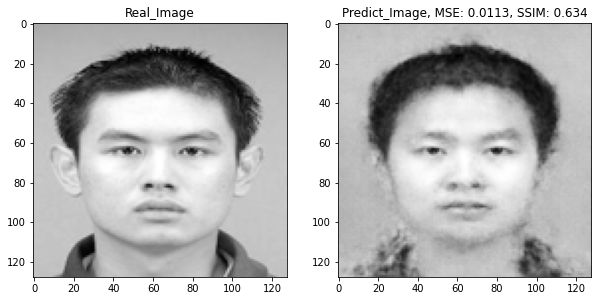

1/1 [==============================] - 0s 21ms/step


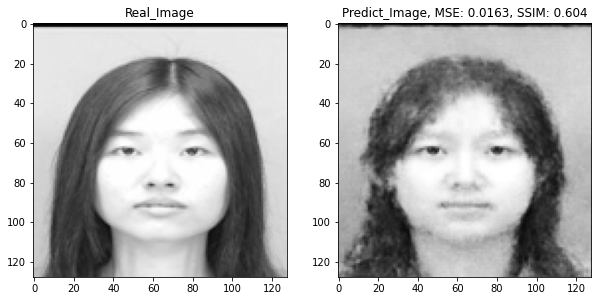

1/1 [==============================] - 0s 21ms/step


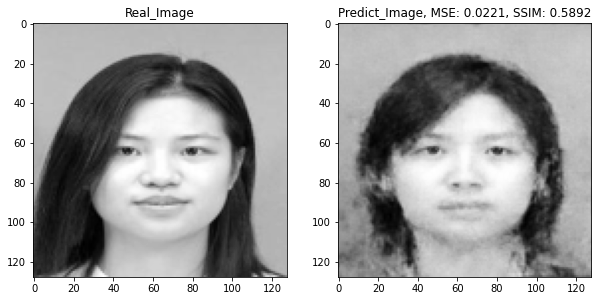

1/1 [==============================] - 0s 21ms/step


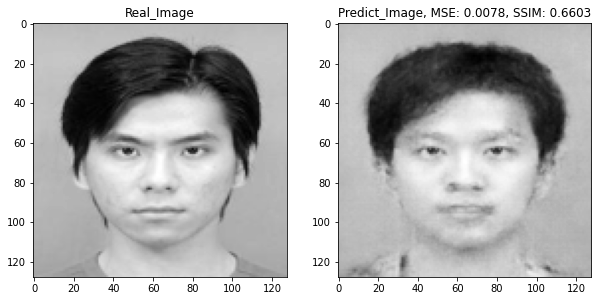

1/1 [==============================] - 0s 21ms/step


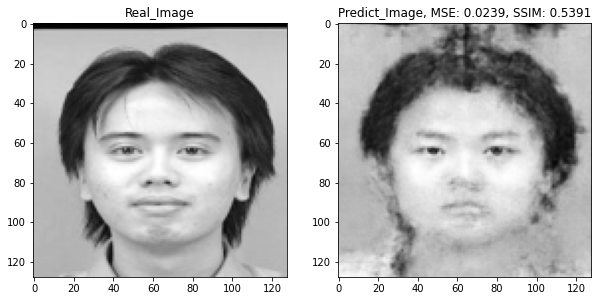

1/1 [==============================] - 0s 24ms/step


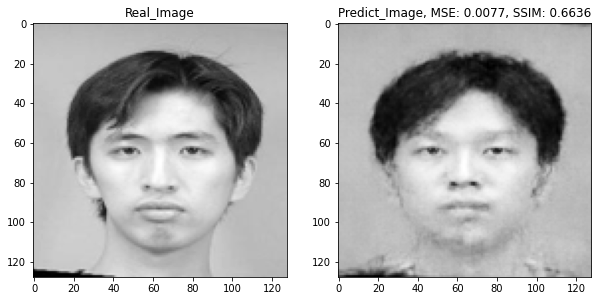

1/1 [==============================] - 0s 22ms/step


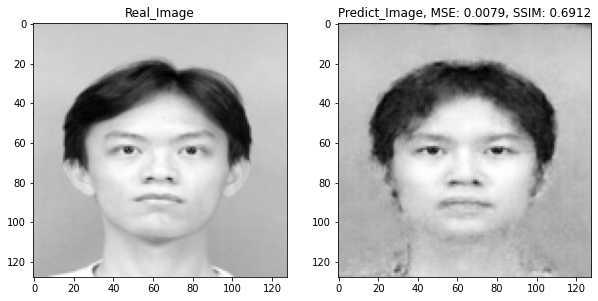

1/1 [==============================] - 0s 27ms/step


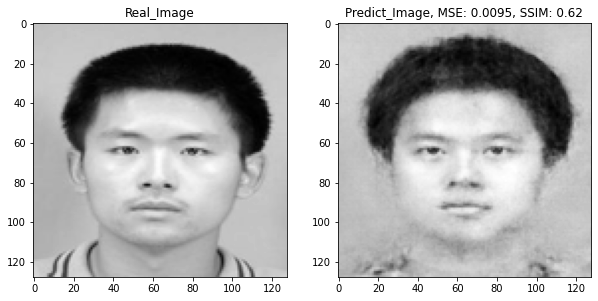

1/1 [==============================] - 0s 22ms/step


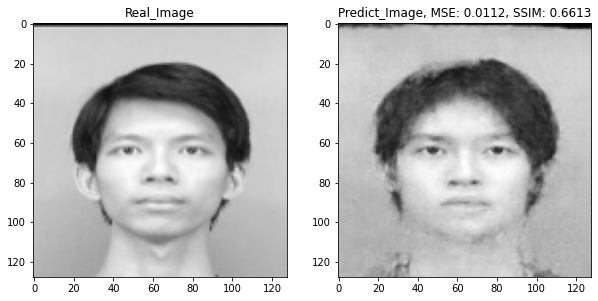

1/1 [==============================] - 0s 32ms/step


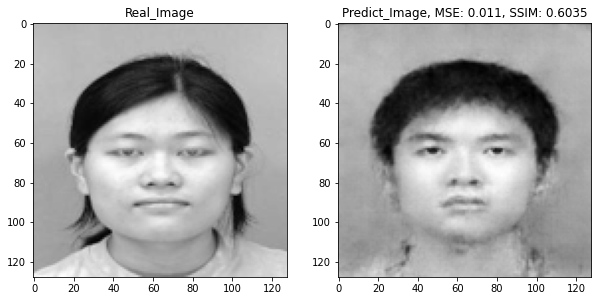

1/1 [==============================] - 0s 21ms/step


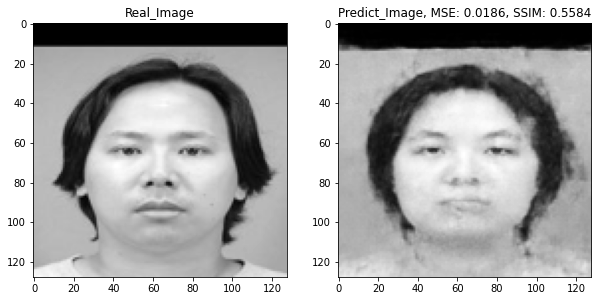

1/1 [==============================] - 0s 30ms/step


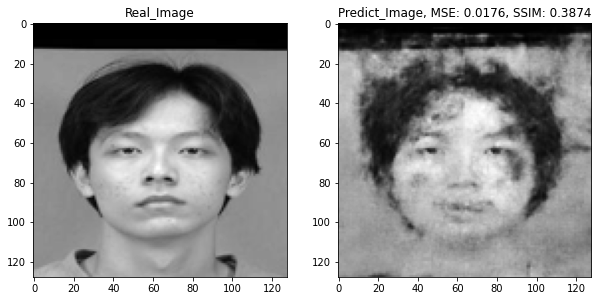

1/1 [==============================] - 0s 29ms/step


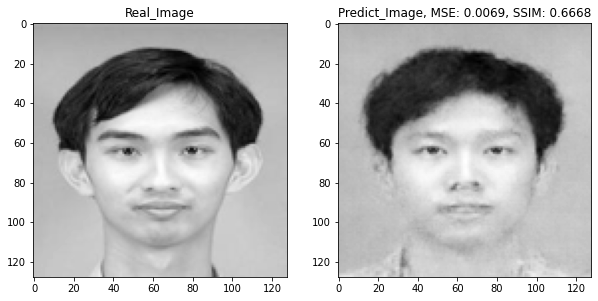

1/1 [==============================] - 0s 22ms/step


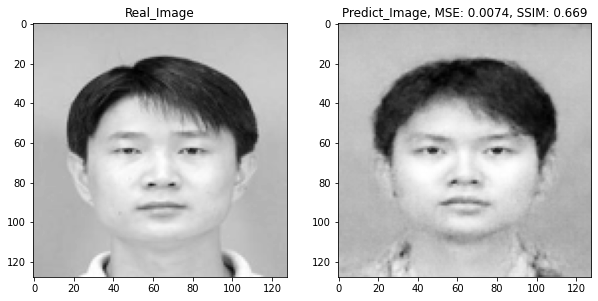

1/1 [==============================] - 0s 25ms/step


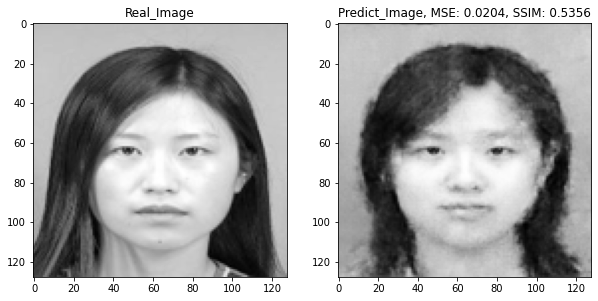

1/1 [==============================] - 0s 31ms/step


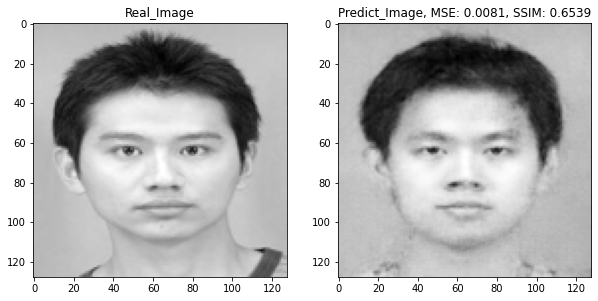

1/1 [==============================] - 0s 22ms/step


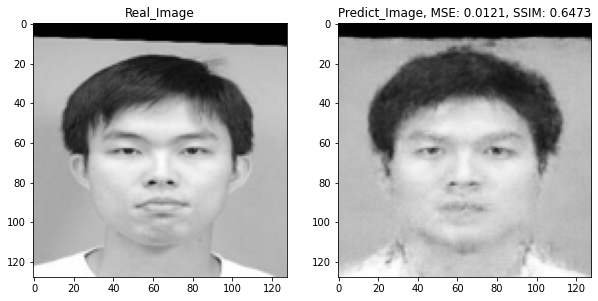

1/1 [==============================] - 0s 25ms/step


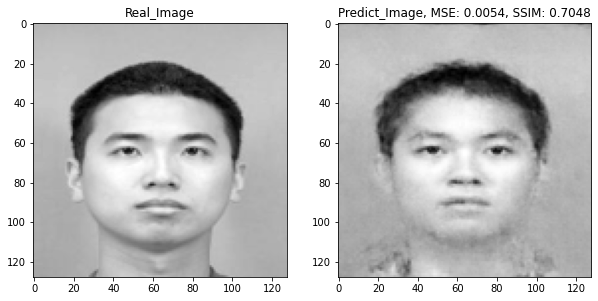

1/1 [==============================] - 0s 22ms/step


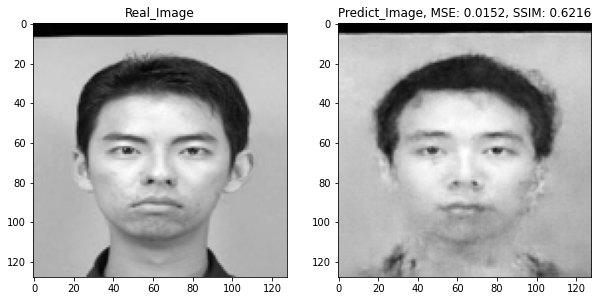

1/1 [==============================] - 0s 26ms/step


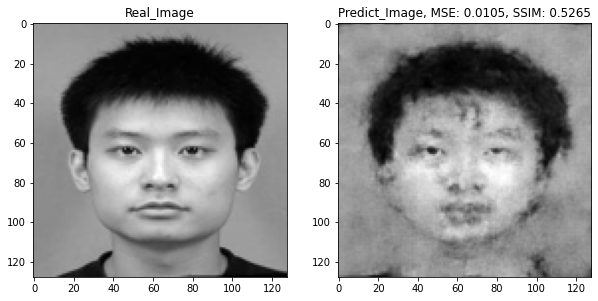

1/1 [==============================] - 0s 23ms/step


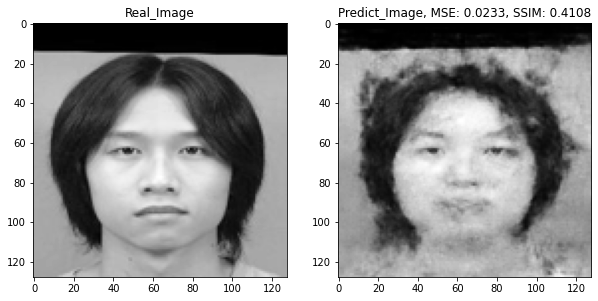

1/1 [==============================] - 0s 21ms/step


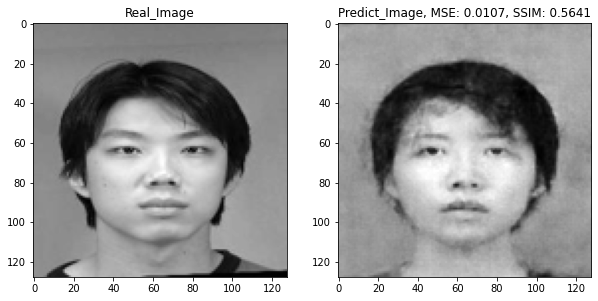

1/1 [==============================] - 0s 23ms/step


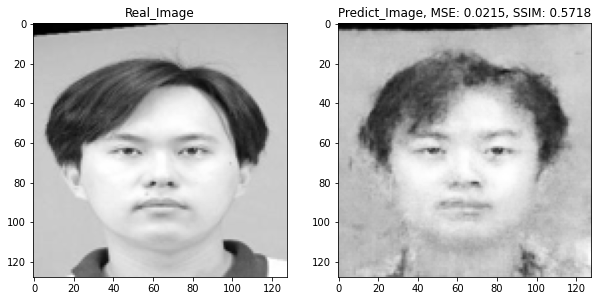

1/1 [==============================] - 0s 28ms/step


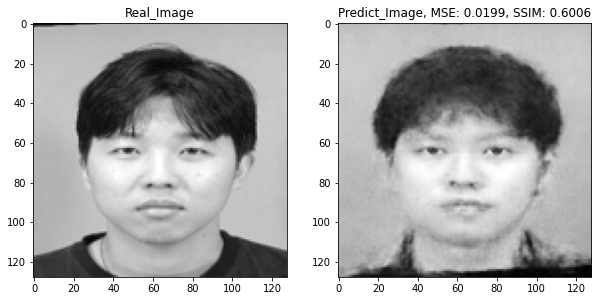

1/1 [==============================] - 0s 21ms/step


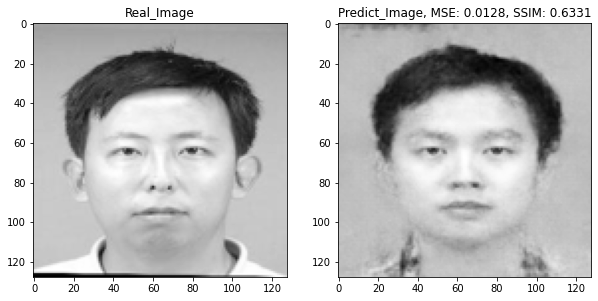

1/1 [==============================] - 0s 21ms/step


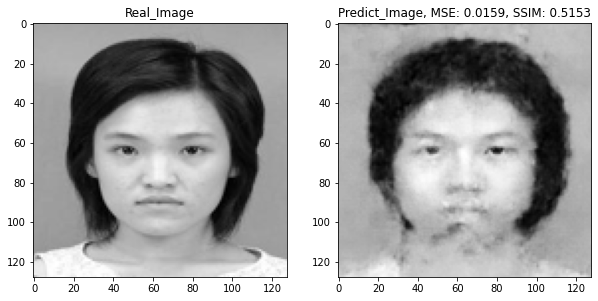

1/1 [==============================] - 0s 21ms/step


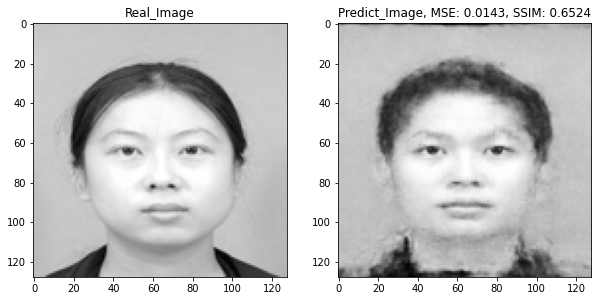

1/1 [==============================] - 0s 22ms/step


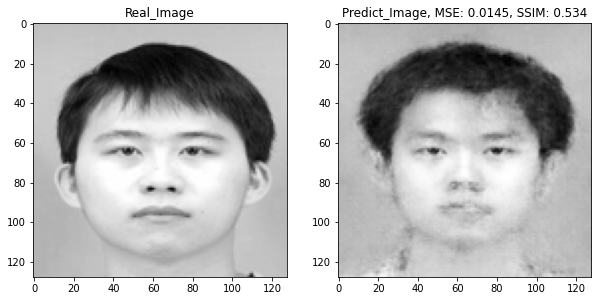

1/1 [==============================] - 0s 21ms/step


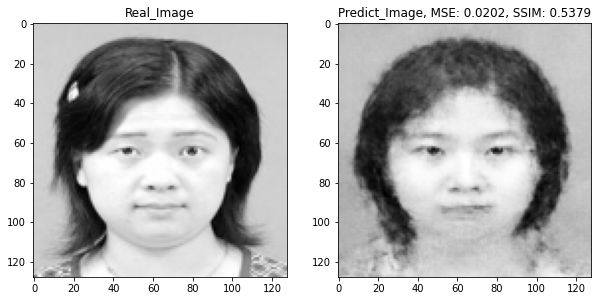

1/1 [==============================] - 0s 23ms/step


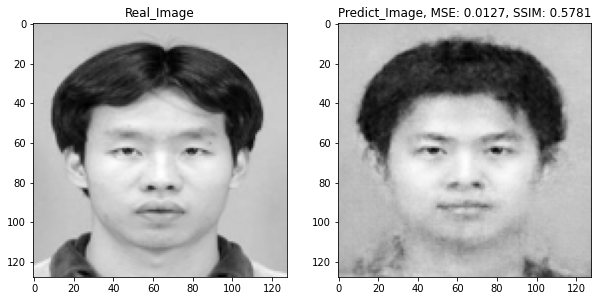

1/1 [==============================] - 0s 23ms/step


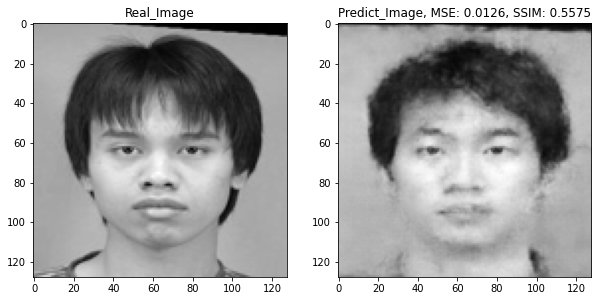

1/1 [==============================] - 0s 21ms/step


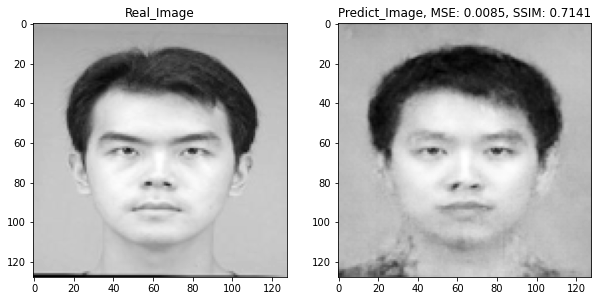

1/1 [==============================] - 0s 22ms/step


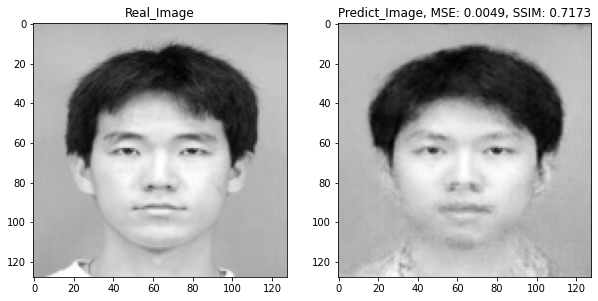

1/1 [==============================] - 0s 22ms/step


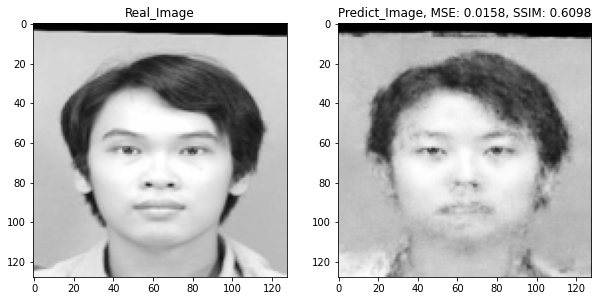

1/1 [==============================] - 0s 21ms/step


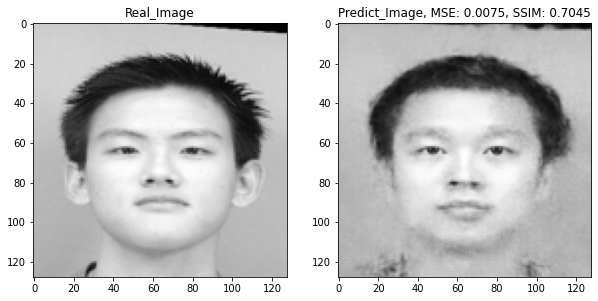

1/1 [==============================] - 0s 23ms/step


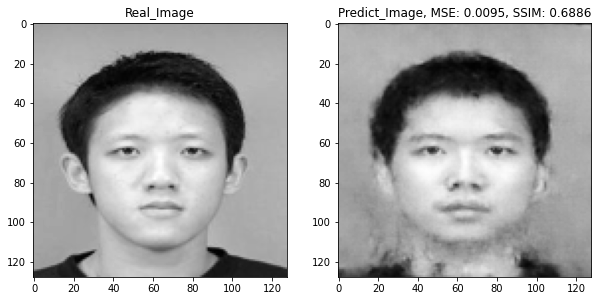

1/1 [==============================] - 0s 21ms/step


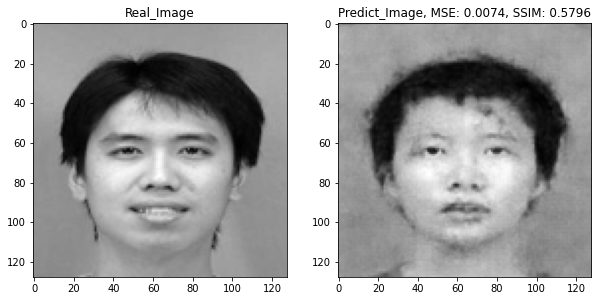

1/1 [==============================] - 0s 21ms/step


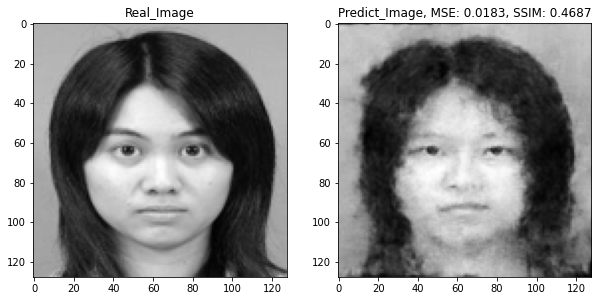

1/1 [==============================] - 0s 20ms/step


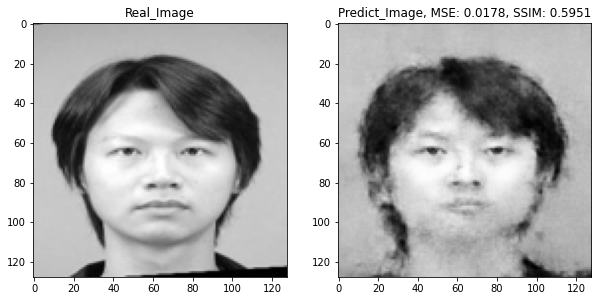

1/1 [==============================] - 0s 21ms/step


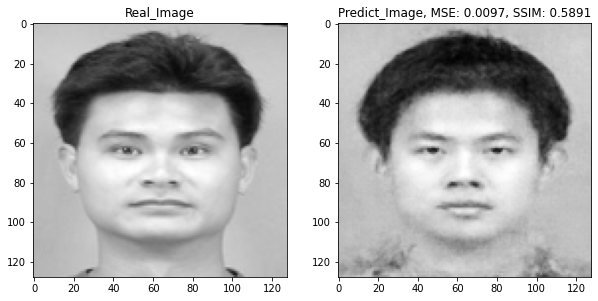

1/1 [==============================] - 0s 30ms/step


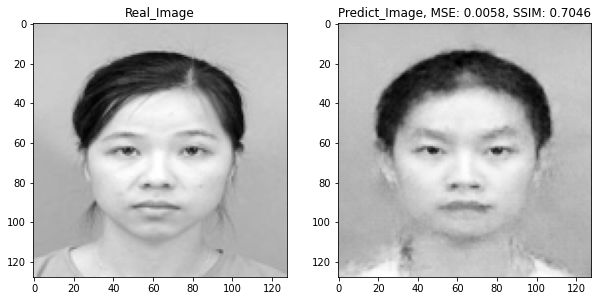

1/1 [==============================] - 0s 28ms/step


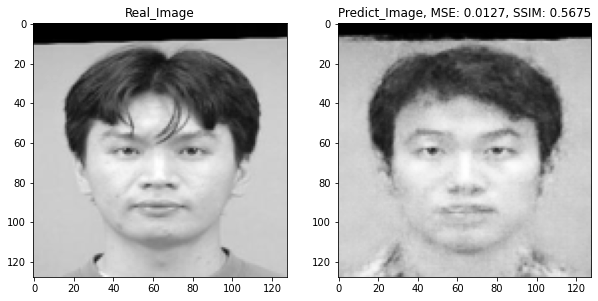

1/1 [==============================] - 0s 23ms/step


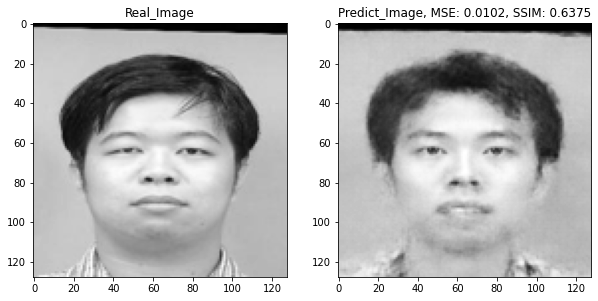

1/1 [==============================] - 0s 32ms/step


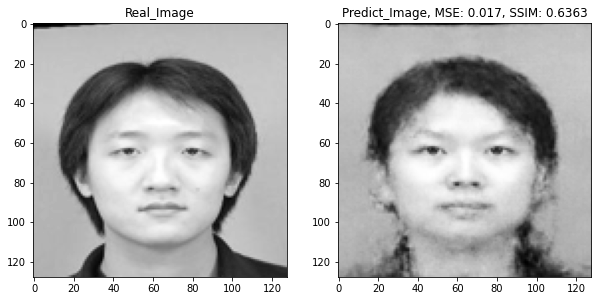

1/1 [==============================] - 0s 25ms/step


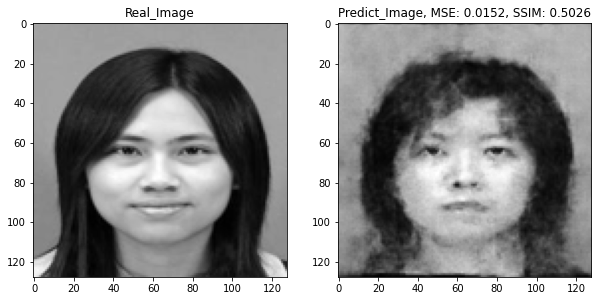

1/1 [==============================] - 0s 21ms/step


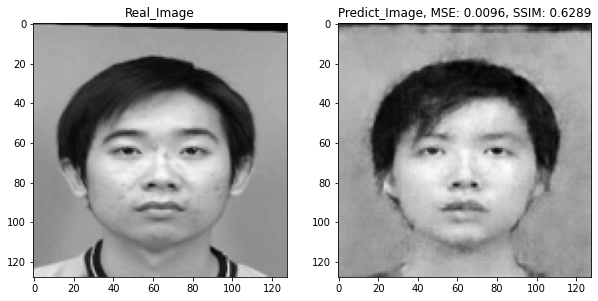

1/1 [==============================] - 0s 22ms/step


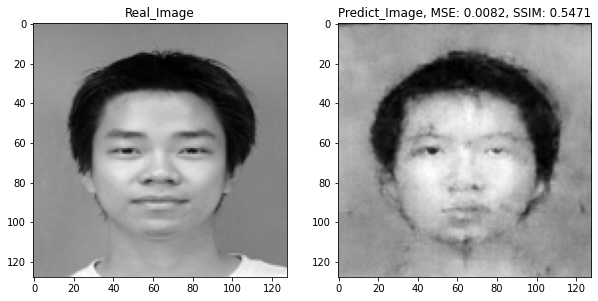

1/1 [==============================] - 0s 28ms/step


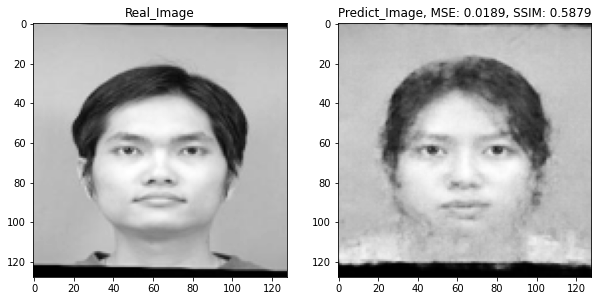

1/1 [==============================] - 0s 22ms/step


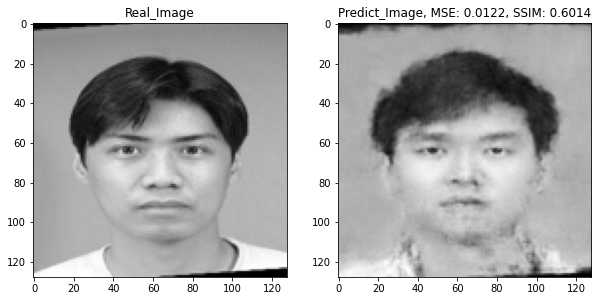

1/1 [==============================] - 0s 22ms/step


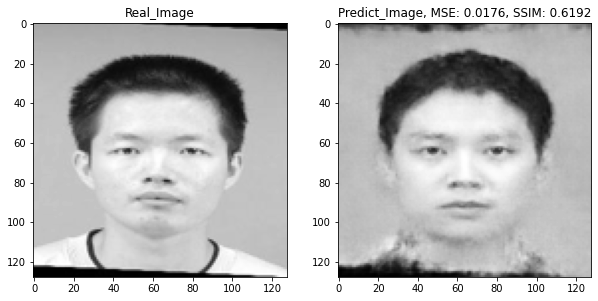

1/1 [==============================] - 0s 22ms/step


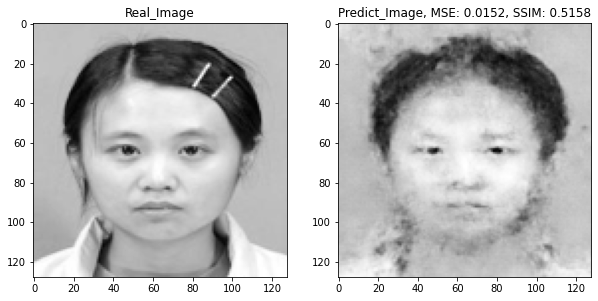

1/1 [==============================] - 0s 22ms/step


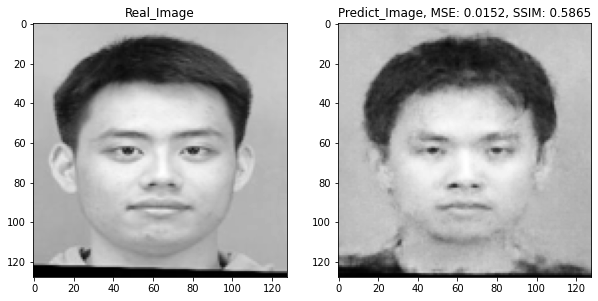

1/1 [==============================] - 0s 21ms/step


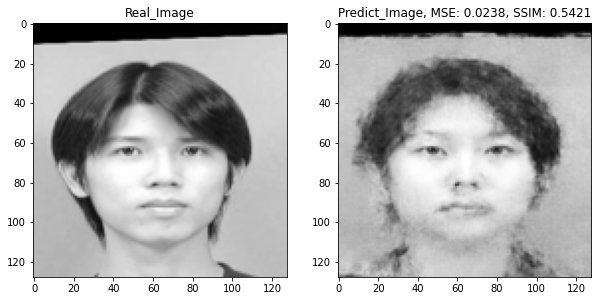

1/1 [==============================] - 0s 22ms/step


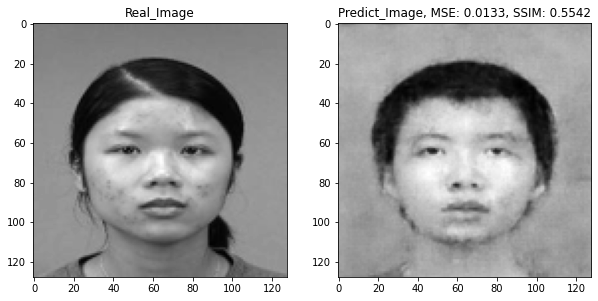

1/1 [==============================] - 0s 27ms/step


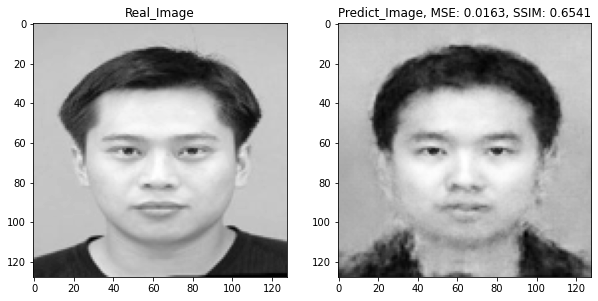

1/1 [==============================] - 0s 26ms/step


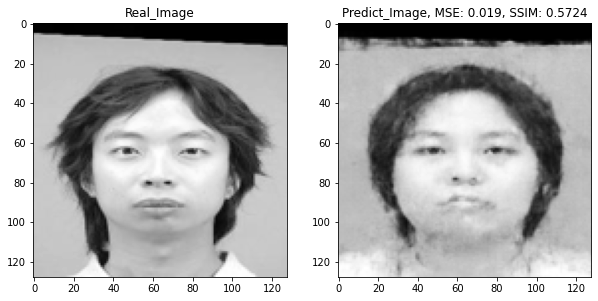

1/1 [==============================] - 0s 22ms/step


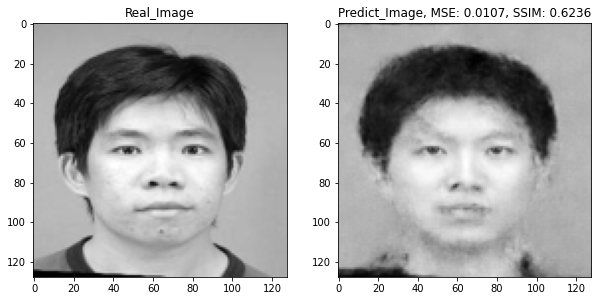

1/1 [==============================] - 0s 21ms/step


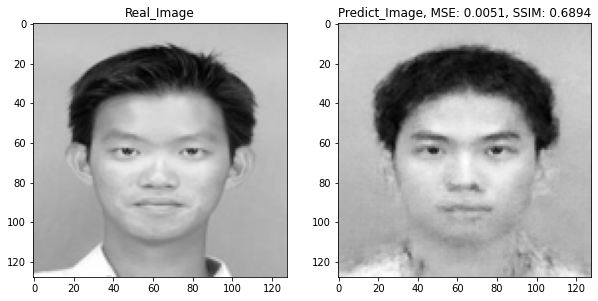

1/1 [==============================] - 0s 21ms/step


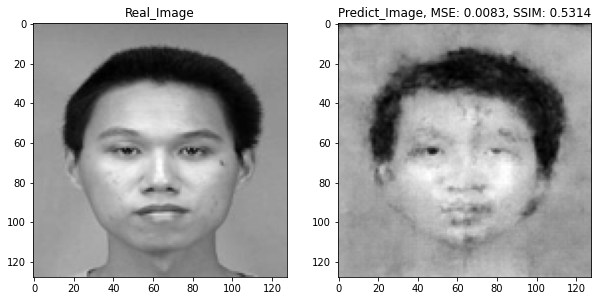

1/1 [==============================] - 0s 20ms/step


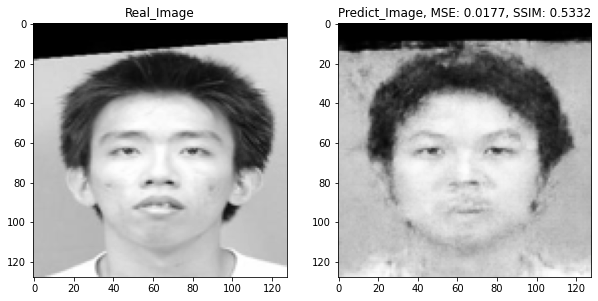

1/1 [==============================] - 0s 21ms/step


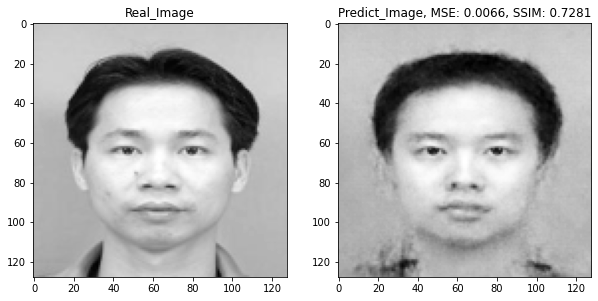

1/1 [==============================] - 0s 20ms/step


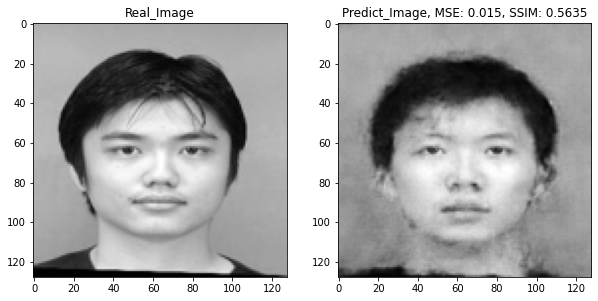

1/1 [==============================] - 0s 21ms/step


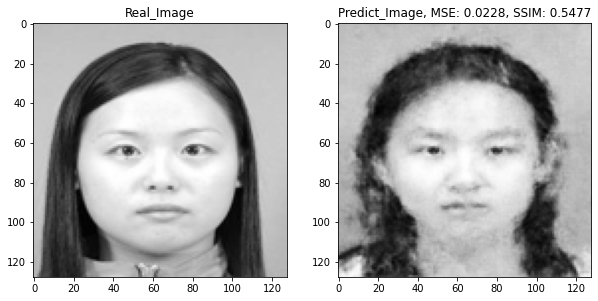

1/1 [==============================] - 0s 22ms/step


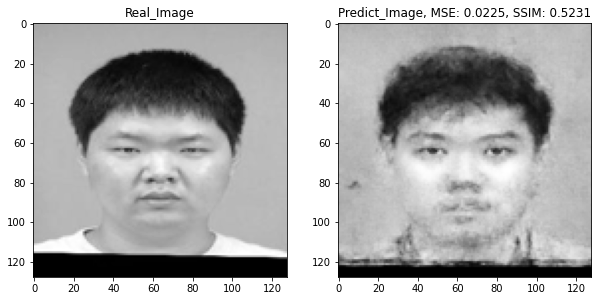

1/1 [==============================] - 0s 21ms/step


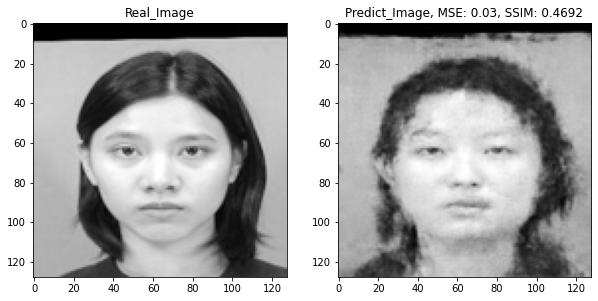

The overall MSE analysis of test dataset: Mean:0.0137, Max:0.03, Min:0.0047
The overall SSIM analysis of test dataset: Mean:0.5945, Max:0.7407, Min:0.3874


In [ ]:
# Store all test cases' evaluations
MSE_all = []
SSIM_all = []
# 使用VAE模型生成素描图片
for fileName in os.listdir(filePath3):
    # 读取输入图片
    image_tmp = Image.open(os.path.join(filePath3, fileName)).convert('L')
    
    # 转换为模型的输入格式
    image_tmp = image_tmp.resize((128, 128))
    img_tmp = np.array(image_tmp).reshape((1,128,128,1)).astype('float32') / 255.

    # 使用VAE模型生成素描图片
#    z_mean,_ = encoder.predict(img_tmp)
#    sketch_img = decoder.predict(x=z_mean)
    sketch_img = preTrained_VAE.predict(img_tmp)

    # 转换为PIL Image格式并保存为文件
    sketch_img = sketch_img[0] * 255.
    #sketch_img = np.clip(sketch_img, 0, 255).astype('uint8')
    sketch_img = sketch_img.astype('uint8').reshape((*sketch_img.shape[:-1],))
    sketch_img = Image.fromarray(sketch_img)

    # Calculate MSE and SSIM of predict Image
    evaluations_tmp = imgPredictionEvaluate(realImg = image_tmp, predictImg = sketch_img)
    mse_tmp = evaluations_tmp[0]
    ssim_tmp = evaluations_tmp[1]
    MSE_all.append(mse_tmp)
    SSIM_all.append(ssim_tmp)
    # 显示生成的素描图片
    plt.figure(figsize = (10,10))
    plt.subplot(1,2,1)
    plt.title('Real_Image')
    plt.imshow(image_tmp, cmap = 'gray')
    plt.subplot(1,2,2)
    name = 'Predict_Image, MSE: {}, SSIM: {}'.format(mse_tmp, ssim_tmp)
    plt.title(name)
    plt.imshow(sketch_img, cmap = 'gray')
    plt.show()

# calculate the overall MSE & SSIM
MSE_all_Mean = round(np.mean(MSE_all), 4)
MSE_all_Max = np.max(MSE_all)
MSE_all_Min = np.min(MSE_all)

SSIM_all_Mean = round(np.mean(SSIM_all), 4)
SSIM_all_Max = np.max(SSIM_all)
SSIM_all_Min = np.min(SSIM_all) 

print('The overall MSE analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(MSE_all_Mean, MSE_all_Max, MSE_all_Min))
print('The overall SSIM analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(SSIM_all_Mean, SSIM_all_Max, SSIM_all_Min))

1/1 [==============================] - 0s 21ms/step


<ipython-input-31-edbfa198a007>:8: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_val_2img = ssim(realImg_array, predictImg_array, multichannel=True)


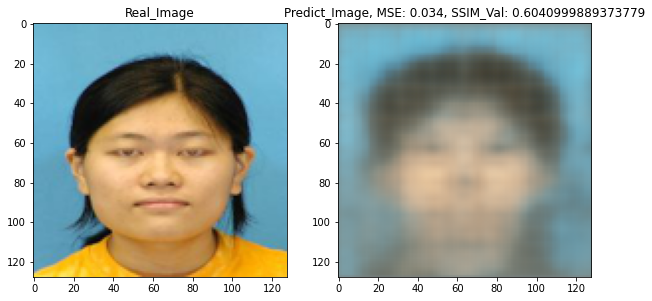

1/1 [==============================] - 0s 21ms/step


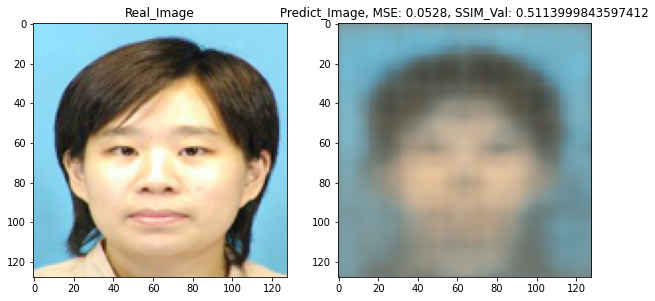

1/1 [==============================] - 0s 21ms/step


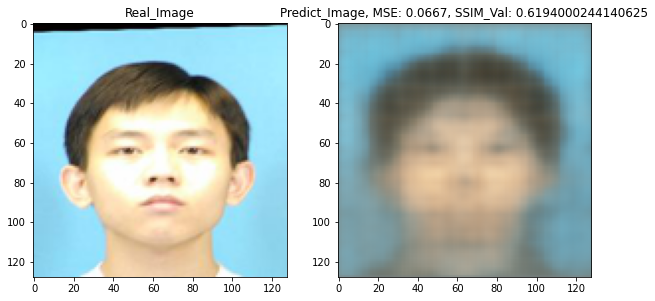

1/1 [==============================] - 0s 22ms/step


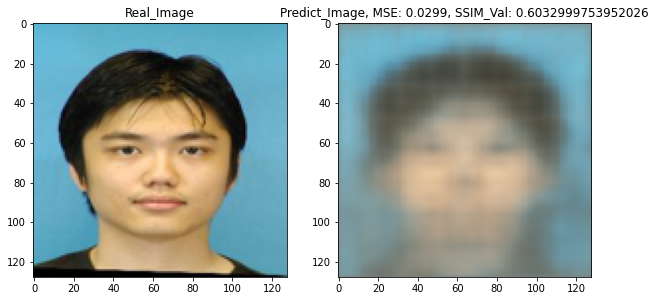

1/1 [==============================] - 0s 22ms/step


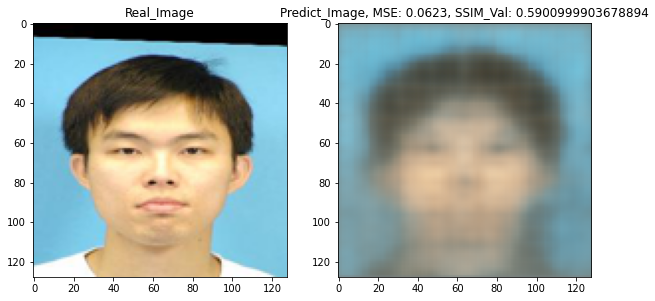

1/1 [==============================] - 0s 21ms/step


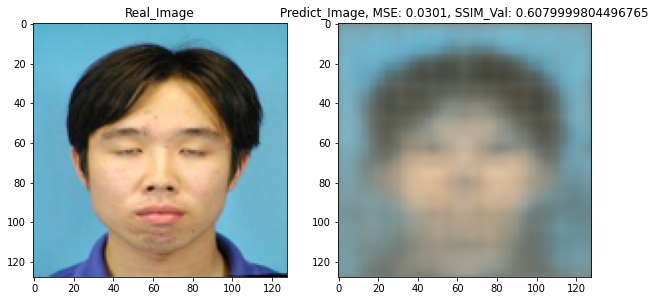

1/1 [==============================] - 0s 22ms/step


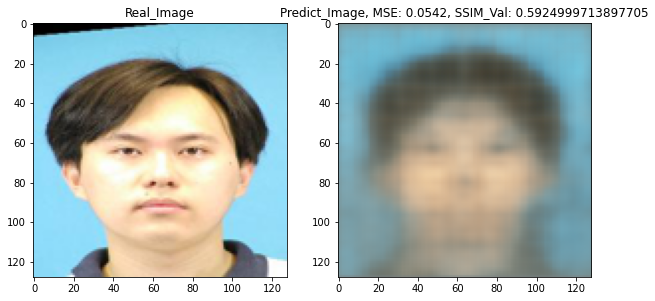

1/1 [==============================] - 0s 21ms/step


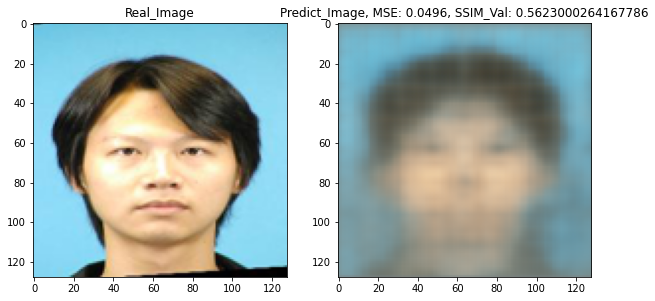

1/1 [==============================] - 0s 21ms/step


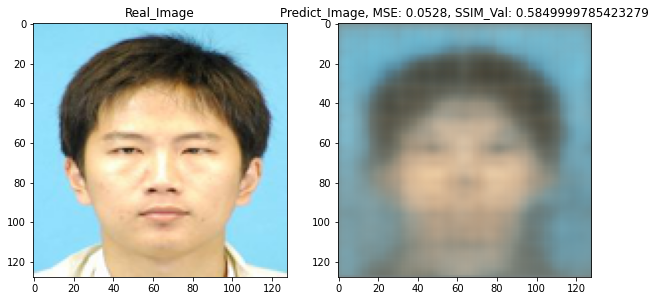

1/1 [==============================] - 0s 22ms/step


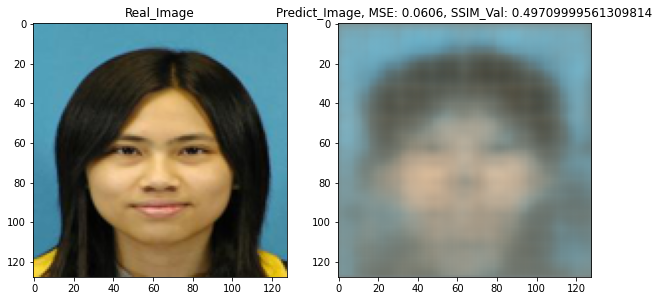

1/1 [==============================] - 0s 21ms/step


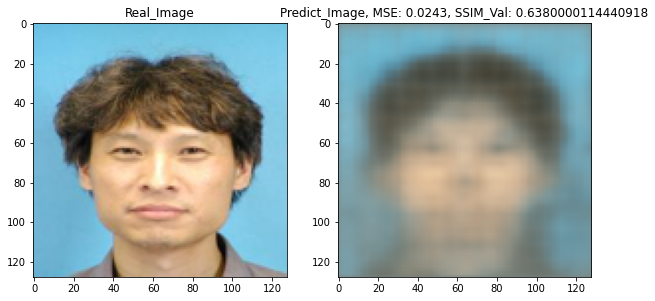

1/1 [==============================] - 0s 20ms/step


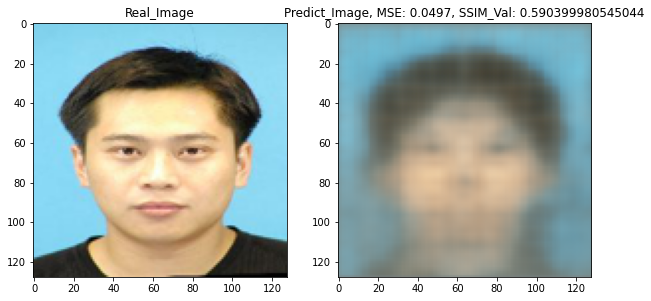

1/1 [==============================] - 0s 20ms/step


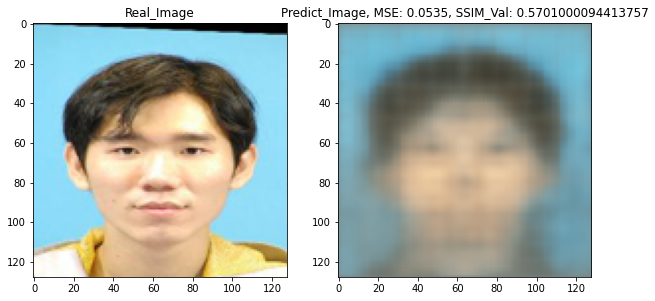

1/1 [==============================] - 0s 24ms/step


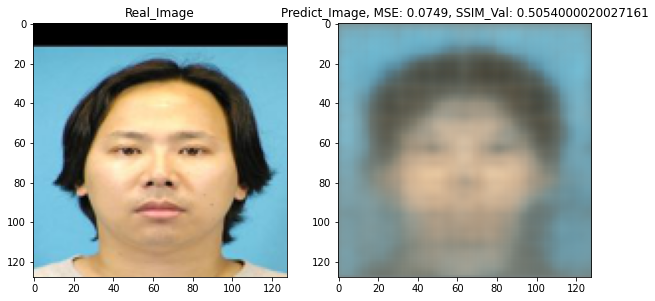

1/1 [==============================] - 0s 23ms/step


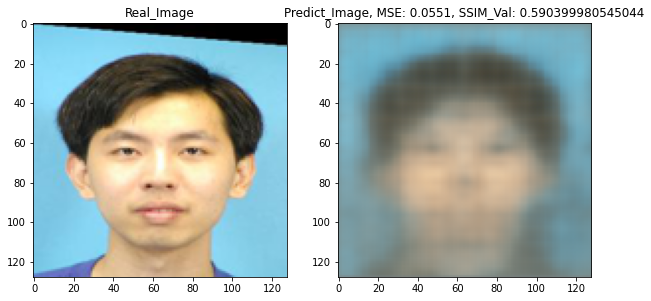

1/1 [==============================] - 0s 22ms/step


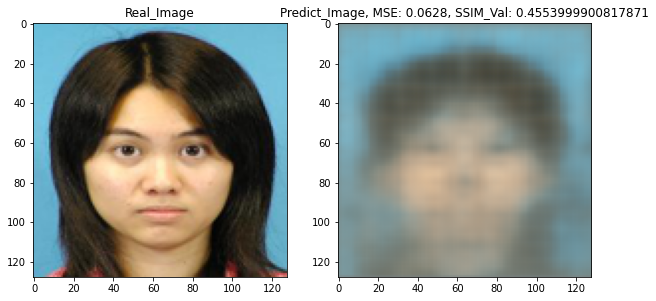

1/1 [==============================] - 0s 26ms/step


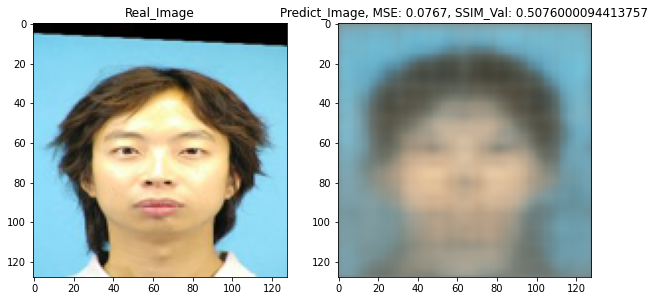

1/1 [==============================] - 0s 27ms/step


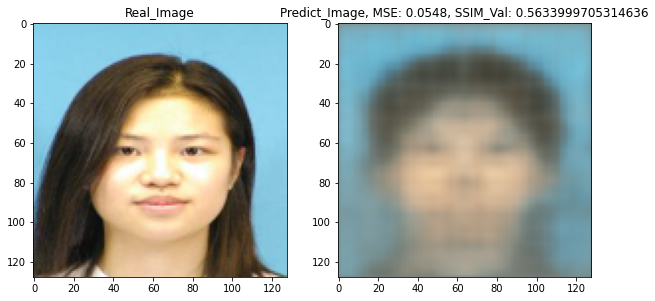

1/1 [==============================] - 0s 33ms/step


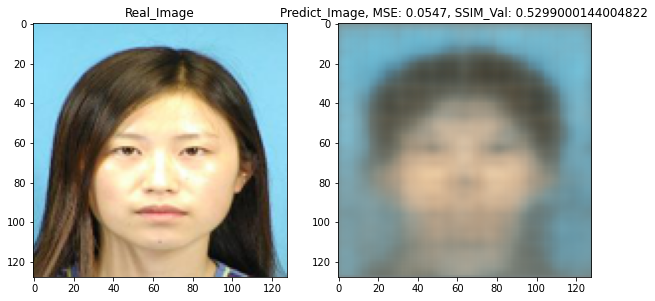

1/1 [==============================] - 0s 22ms/step


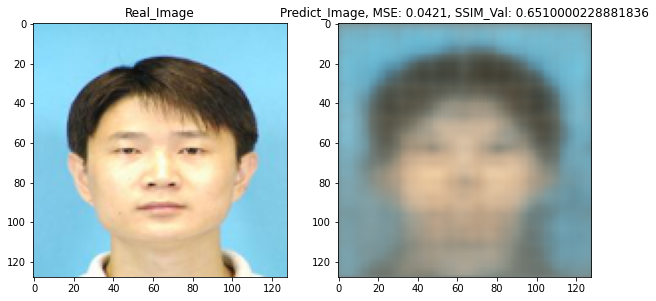

1/1 [==============================] - 0s 22ms/step


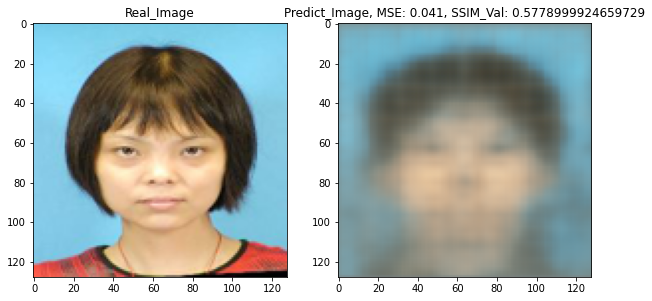

1/1 [==============================] - 0s 21ms/step


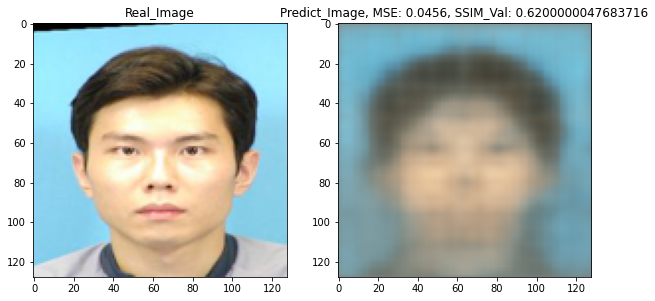

1/1 [==============================] - 0s 22ms/step


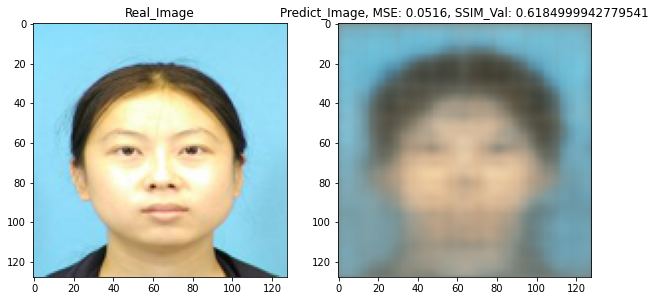

1/1 [==============================] - 0s 22ms/step


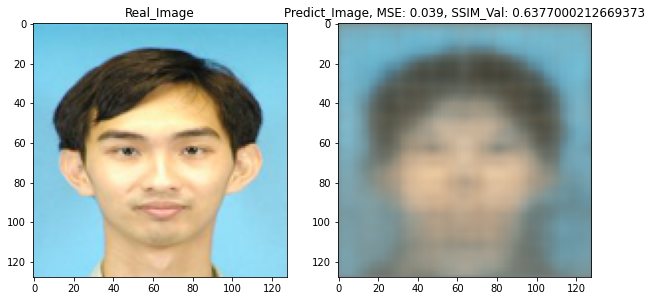

1/1 [==============================] - 0s 21ms/step


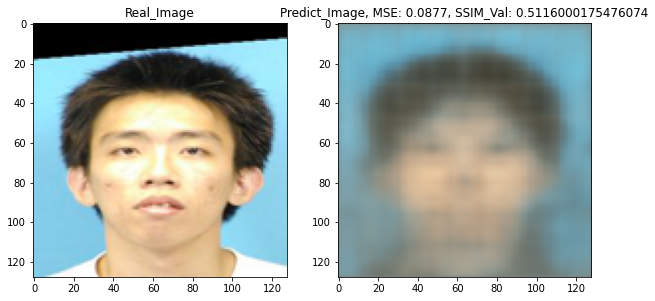

1/1 [==============================] - 0s 28ms/step


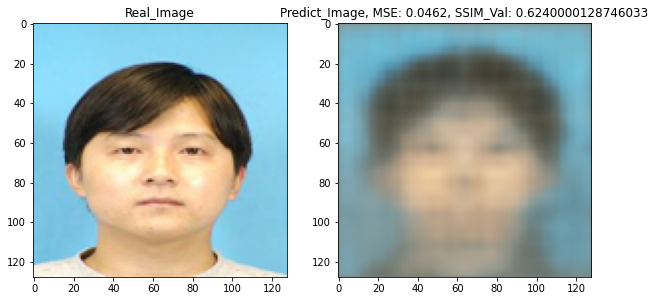

1/1 [==============================] - 0s 21ms/step


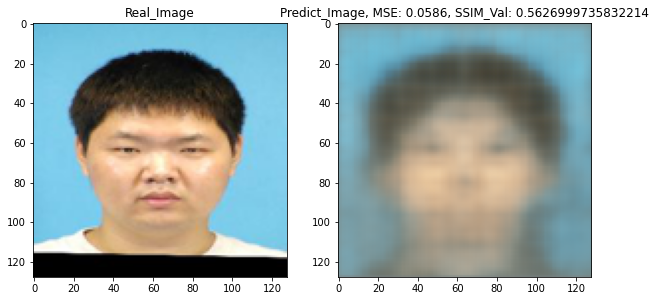

1/1 [==============================] - 0s 22ms/step


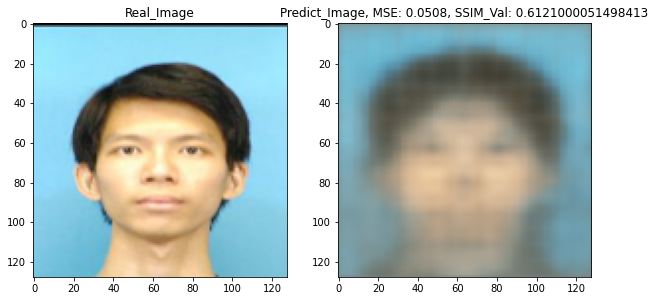

1/1 [==============================] - 0s 30ms/step


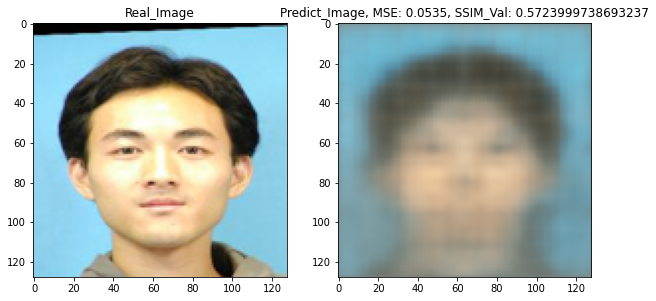

1/1 [==============================] - 0s 21ms/step


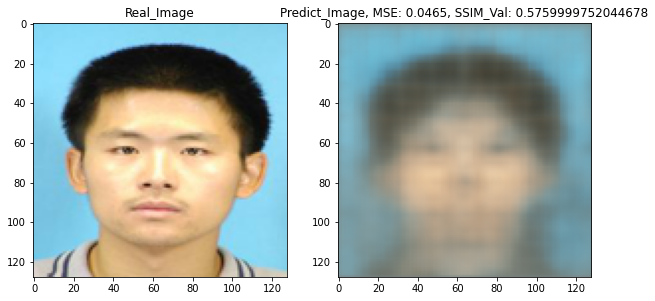

1/1 [==============================] - 0s 21ms/step


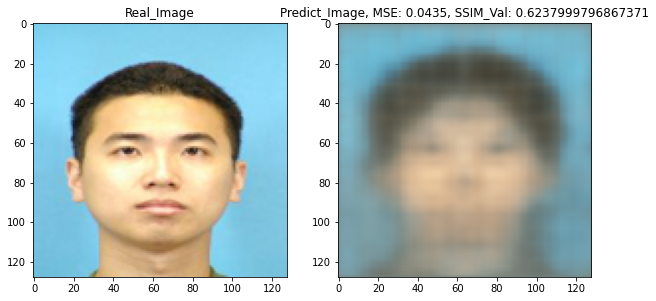

1/1 [==============================] - 0s 22ms/step


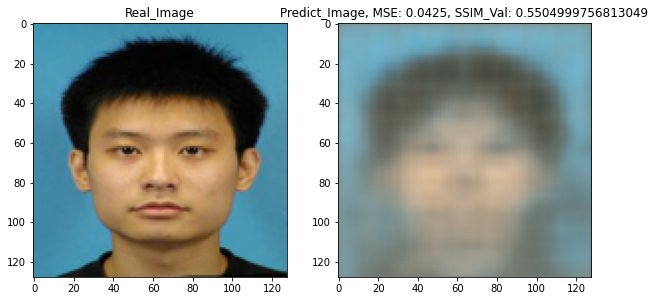

1/1 [==============================] - 0s 21ms/step


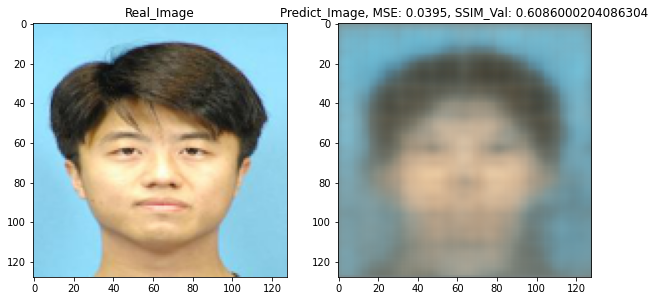

1/1 [==============================] - 0s 21ms/step


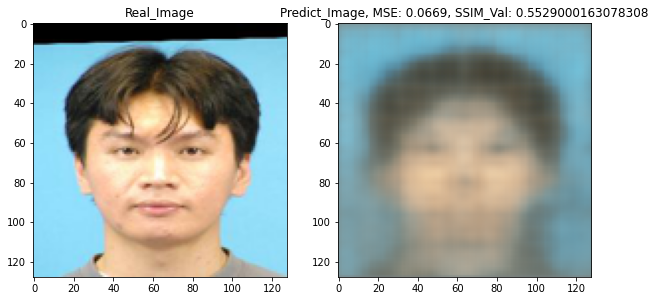

1/1 [==============================] - 0s 22ms/step


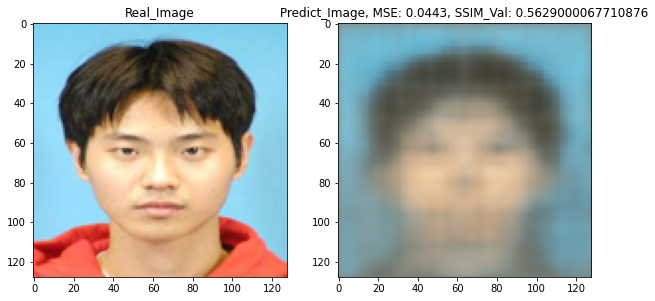

1/1 [==============================] - 0s 21ms/step


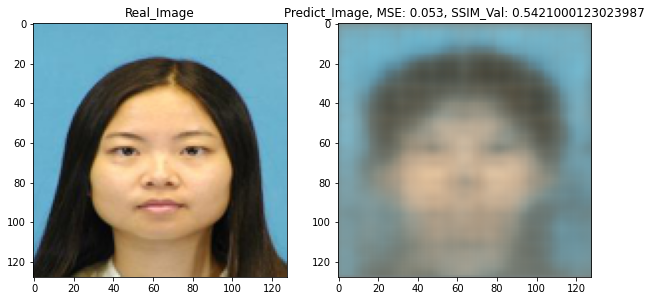

1/1 [==============================] - 0s 21ms/step


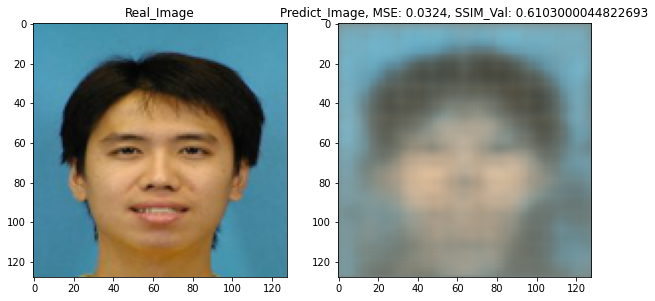

1/1 [==============================] - 0s 21ms/step


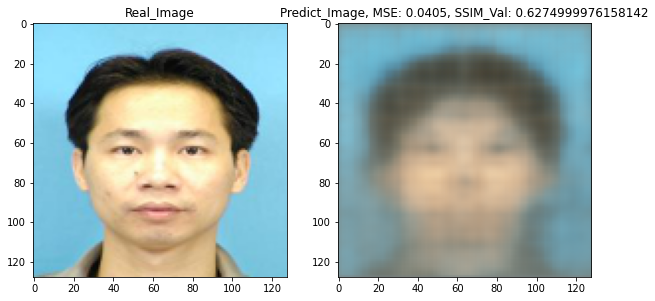

1/1 [==============================] - 0s 20ms/step


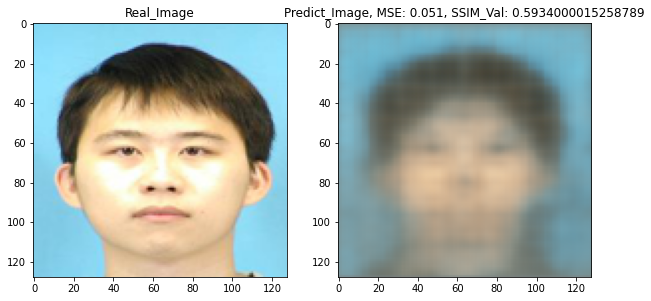

1/1 [==============================] - 0s 20ms/step


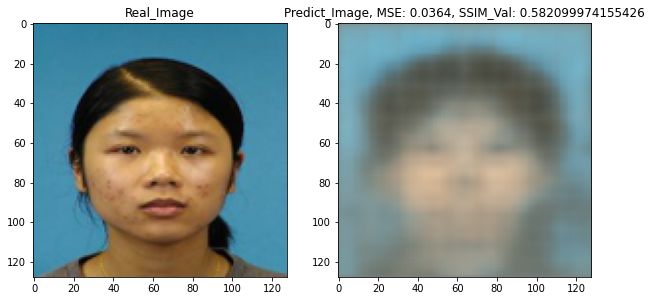

1/1 [==============================] - 0s 21ms/step


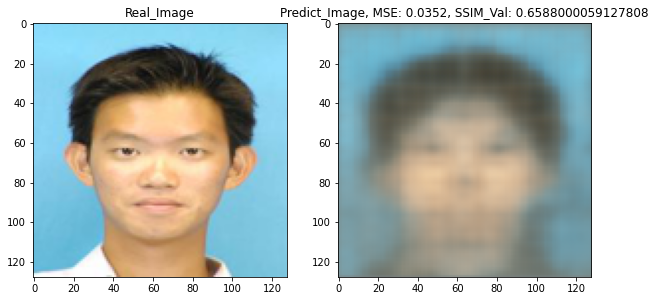

1/1 [==============================] - 0s 24ms/step


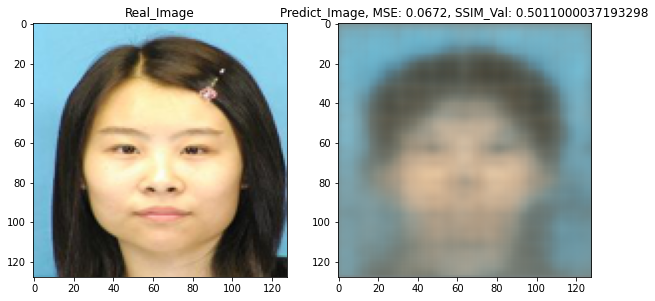

1/1 [==============================] - 0s 26ms/step


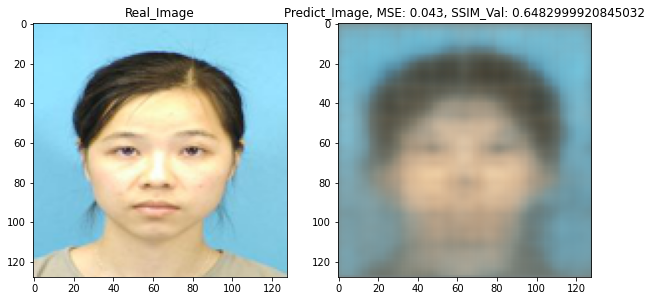

1/1 [==============================] - 0s 22ms/step


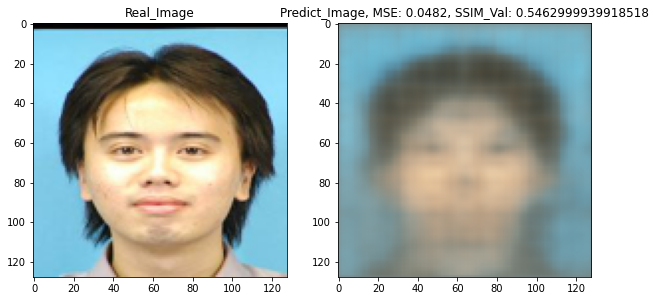

1/1 [==============================] - 0s 29ms/step


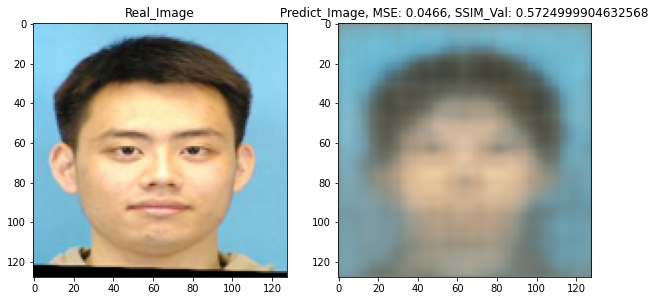

1/1 [==============================] - 0s 32ms/step


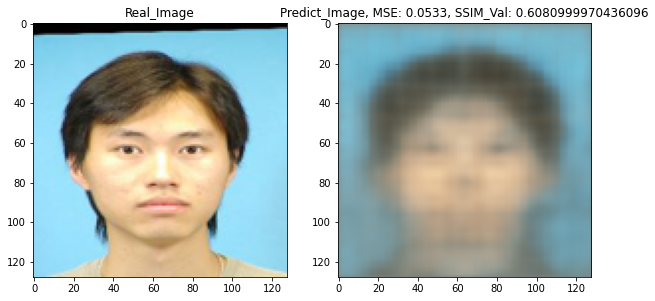

1/1 [==============================] - 0s 27ms/step


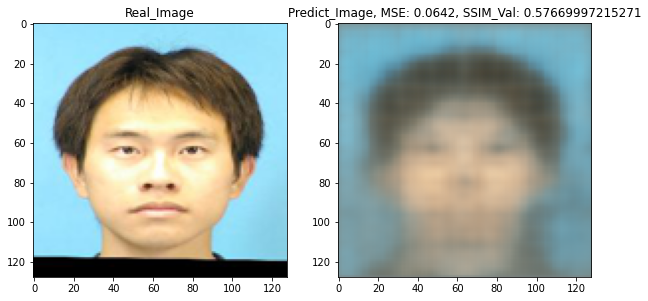

1/1 [==============================] - 0s 22ms/step


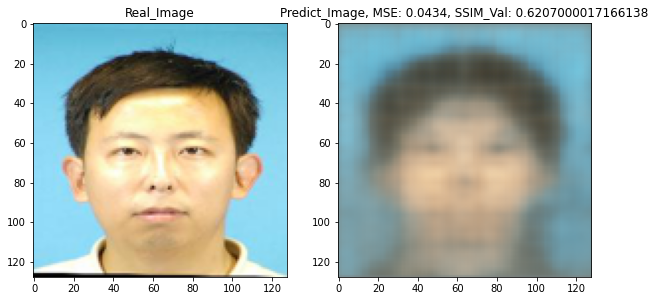

1/1 [==============================] - 0s 22ms/step


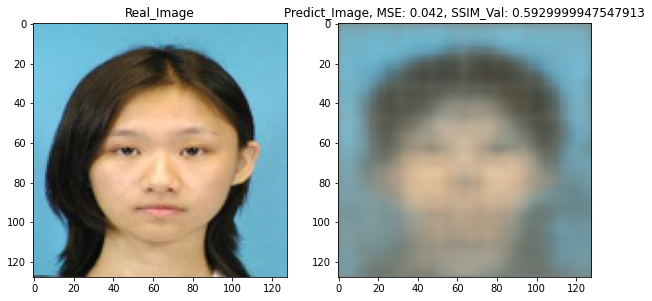

1/1 [==============================] - 0s 22ms/step


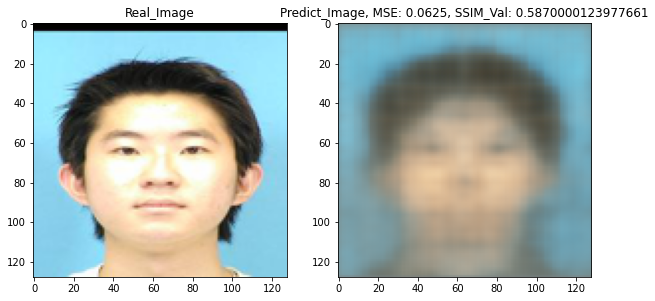

1/1 [==============================] - 0s 22ms/step


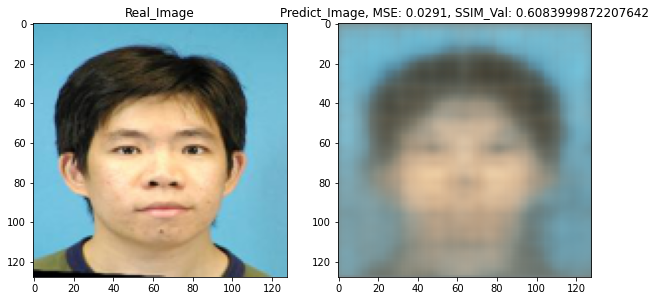

1/1 [==============================] - 0s 21ms/step


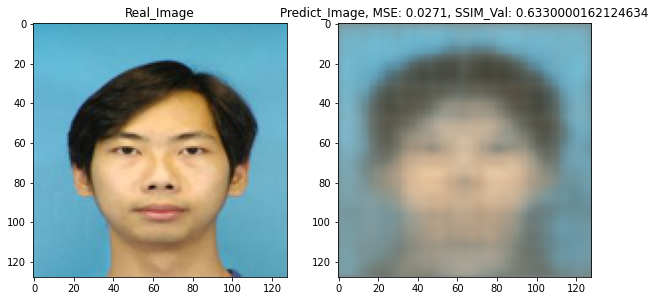

1/1 [==============================] - 0s 22ms/step


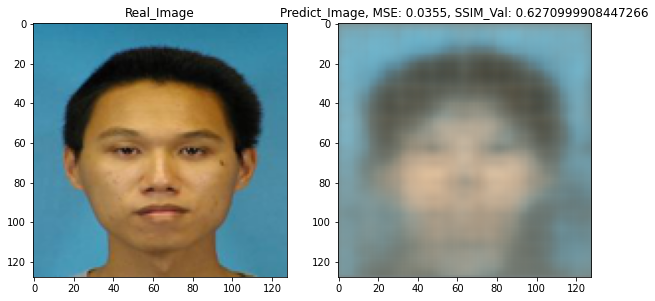

1/1 [==============================] - 0s 24ms/step


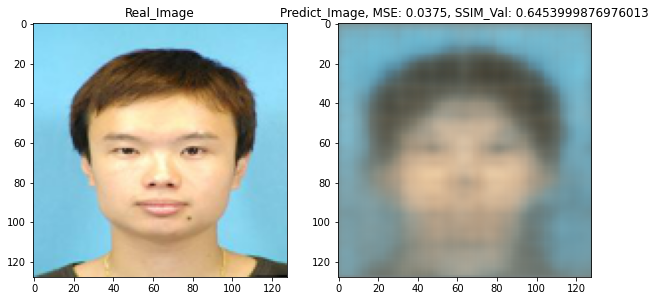

1/1 [==============================] - 0s 22ms/step


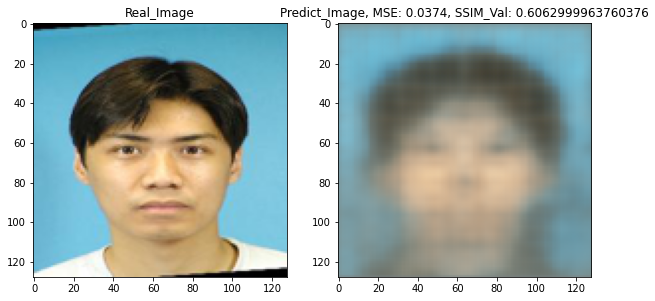

1/1 [==============================] - 0s 21ms/step


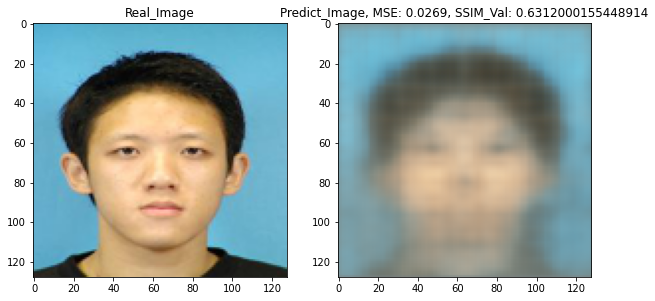

1/1 [==============================] - 0s 21ms/step


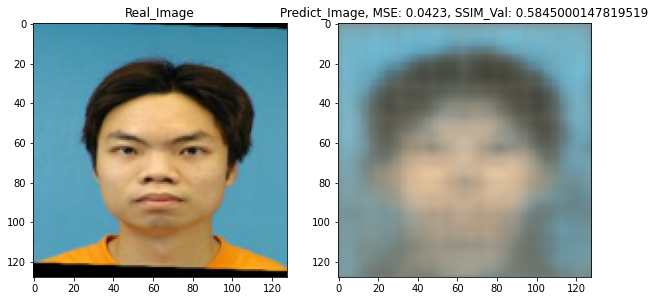

1/1 [==============================] - 0s 21ms/step


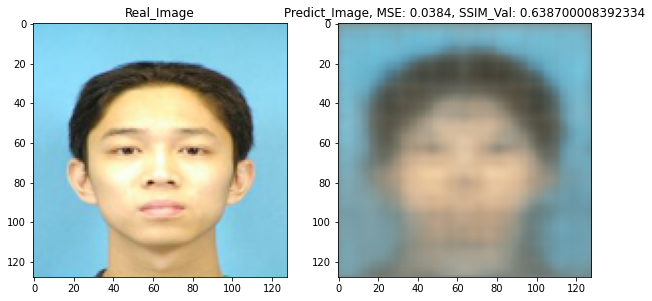

1/1 [==============================] - 0s 22ms/step


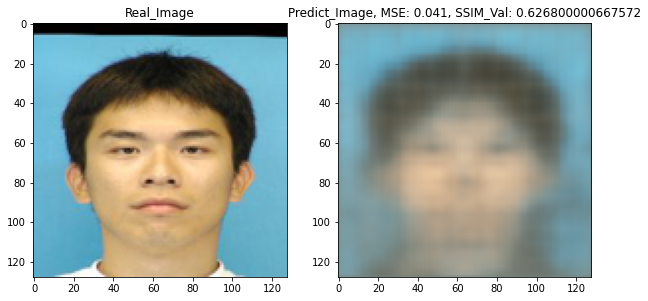

1/1 [==============================] - 0s 22ms/step


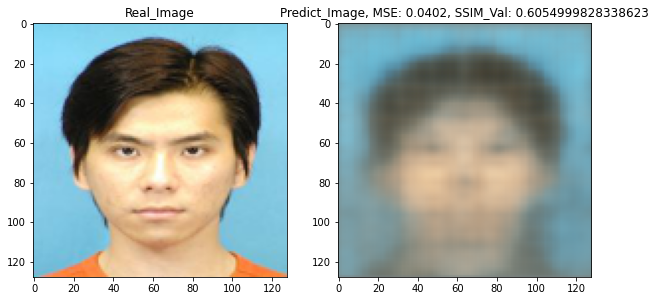

1/1 [==============================] - 0s 21ms/step


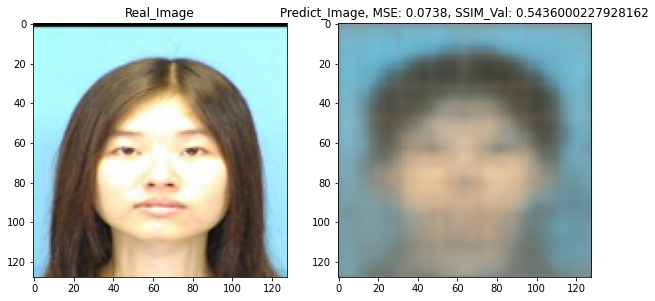

1/1 [==============================] - 0s 21ms/step


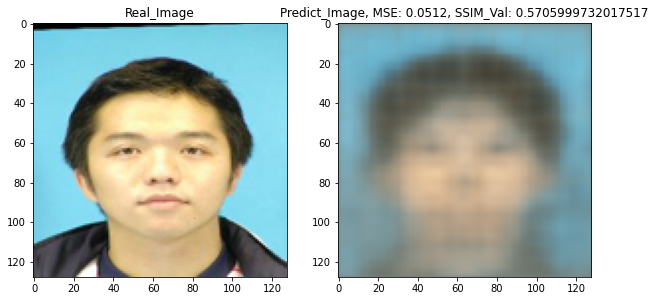

1/1 [==============================] - 0s 22ms/step


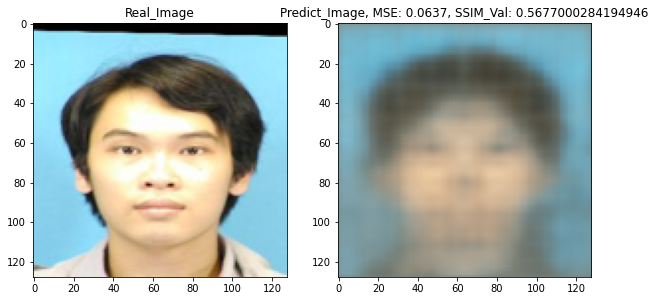

1/1 [==============================] - 0s 21ms/step


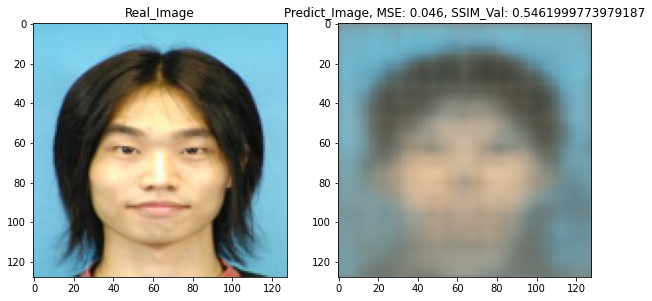

1/1 [==============================] - 0s 21ms/step


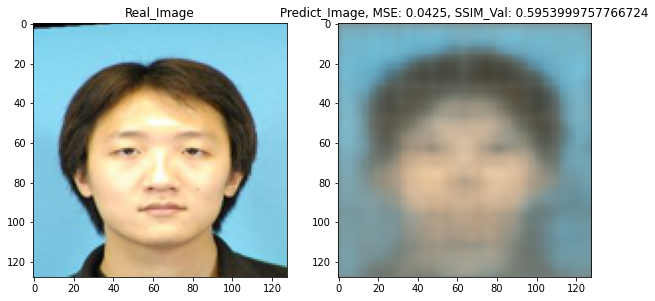

1/1 [==============================] - 0s 22ms/step


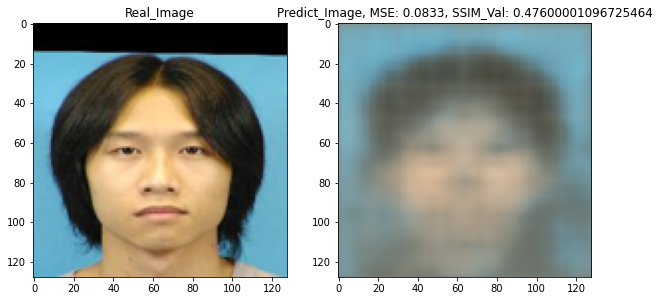

1/1 [==============================] - 0s 23ms/step


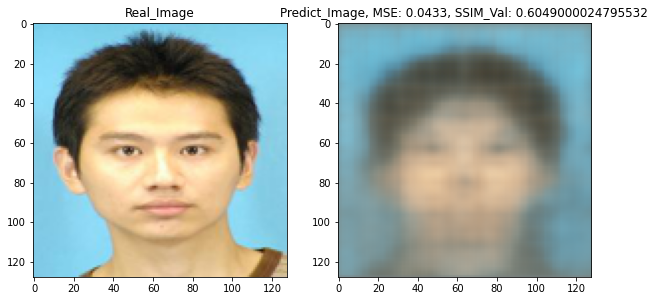

1/1 [==============================] - 0s 21ms/step


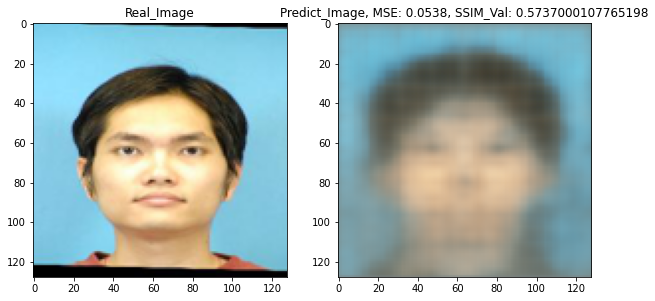

1/1 [==============================] - 0s 23ms/step


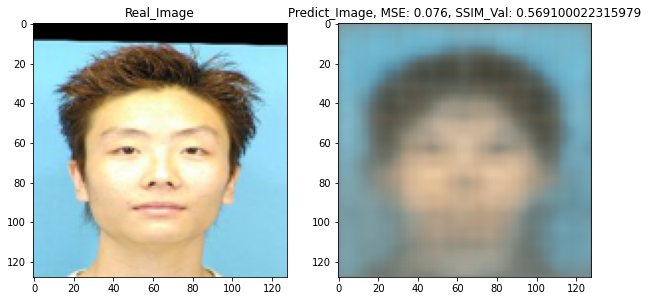

1/1 [==============================] - 0s 22ms/step


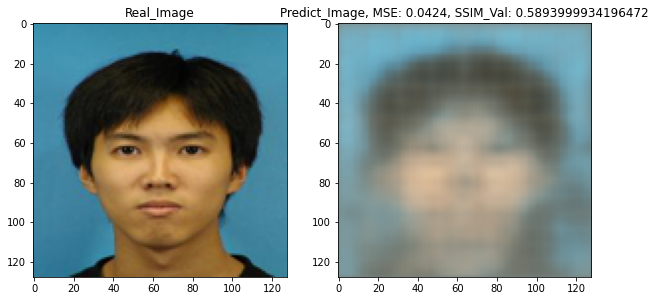

1/1 [==============================] - 0s 22ms/step


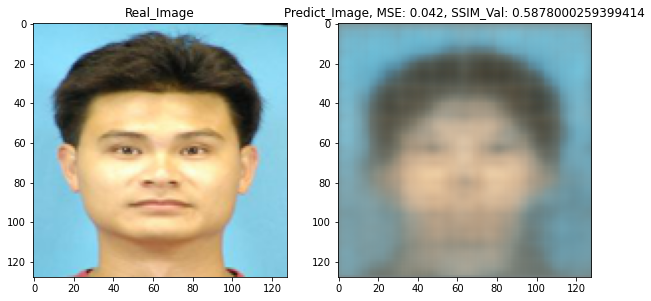

1/1 [==============================] - 0s 21ms/step


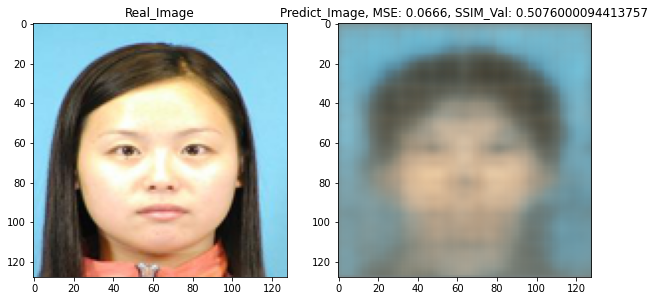

1/1 [==============================] - 0s 22ms/step


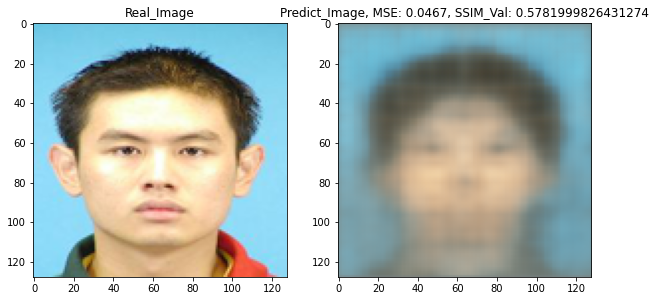

1/1 [==============================] - 0s 22ms/step


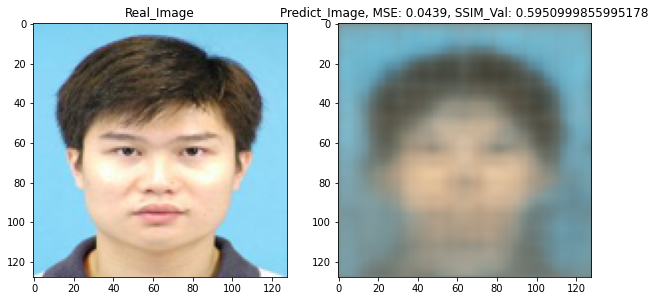

1/1 [==============================] - 0s 22ms/step


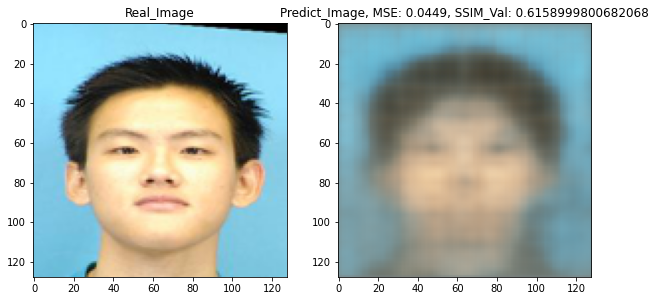

1/1 [==============================] - 0s 22ms/step


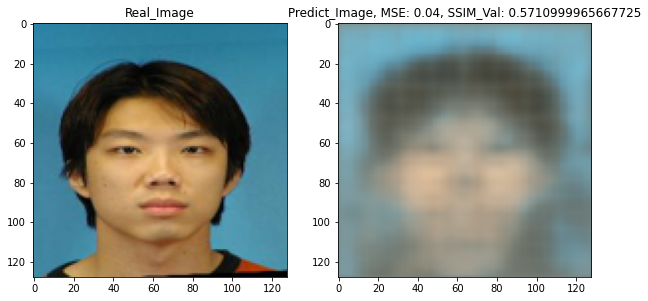

1/1 [==============================] - 0s 21ms/step


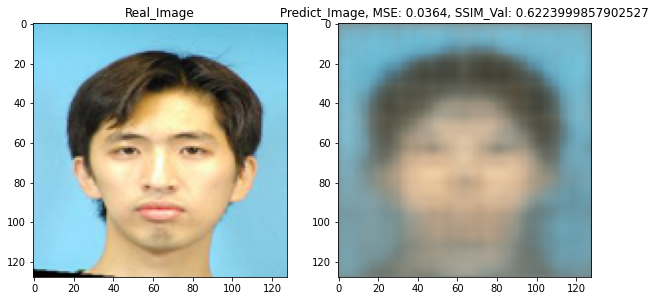

1/1 [==============================] - 0s 21ms/step


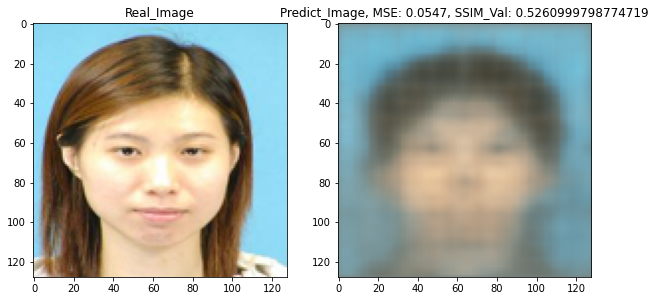

1/1 [==============================] - 0s 21ms/step


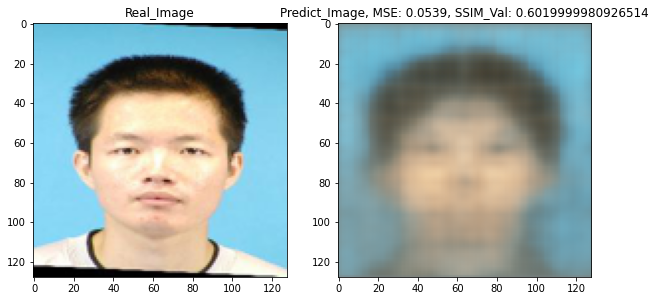

1/1 [==============================] - 0s 24ms/step


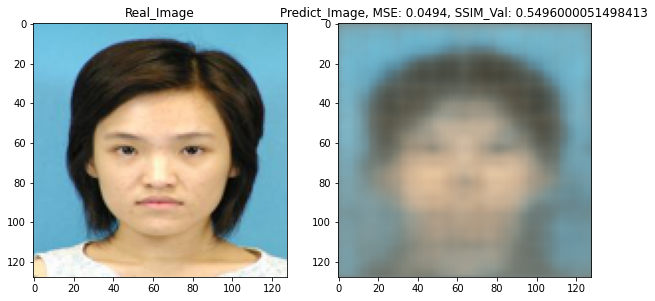

1/1 [==============================] - 0s 21ms/step


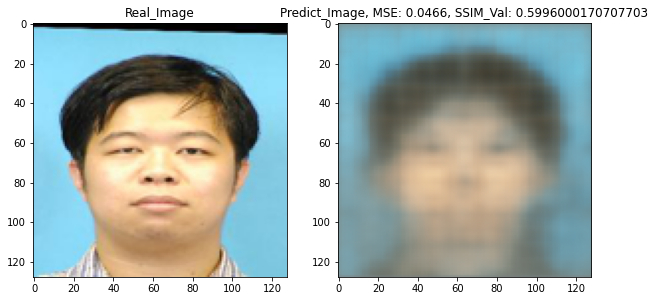

1/1 [==============================] - 0s 21ms/step


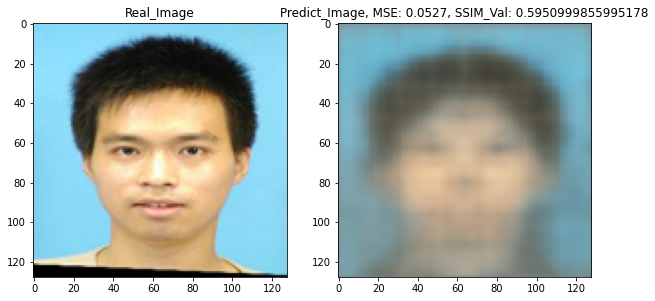

1/1 [==============================] - 0s 21ms/step


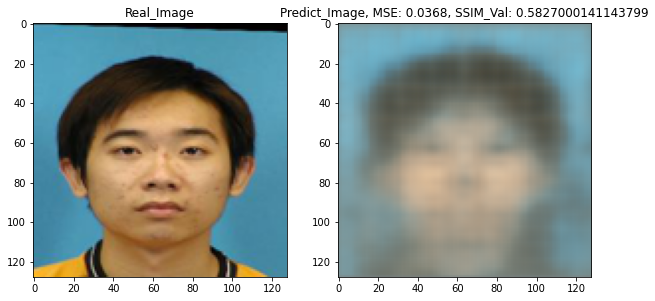

1/1 [==============================] - 0s 22ms/step


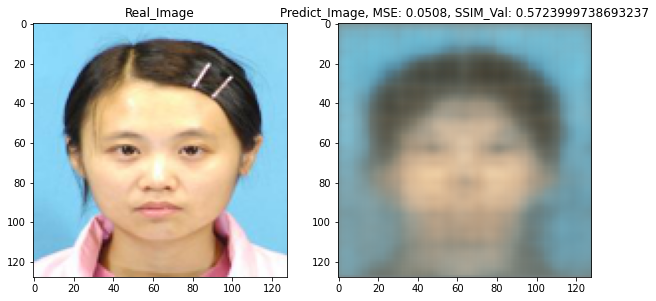

1/1 [==============================] - 0s 21ms/step


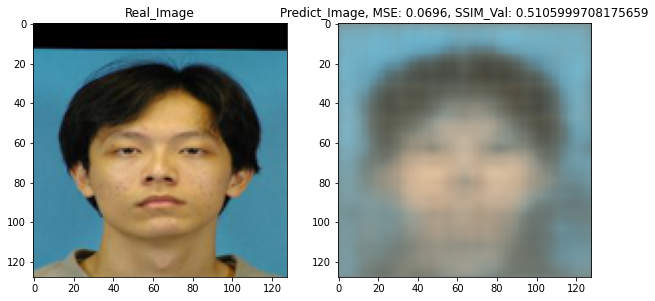

1/1 [==============================] - 0s 22ms/step


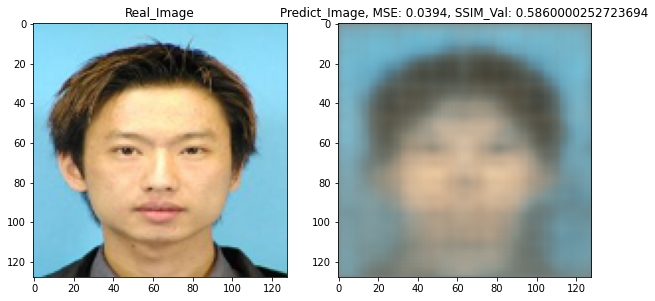

1/1 [==============================] - 0s 21ms/step


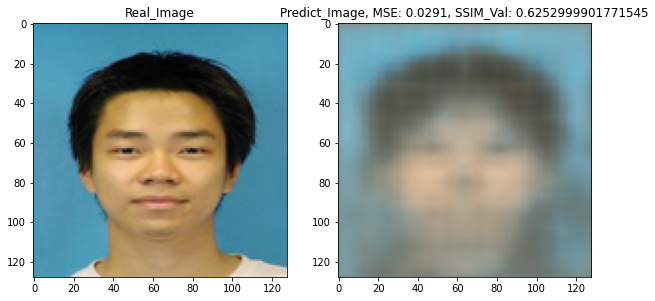

1/1 [==============================] - 0s 20ms/step


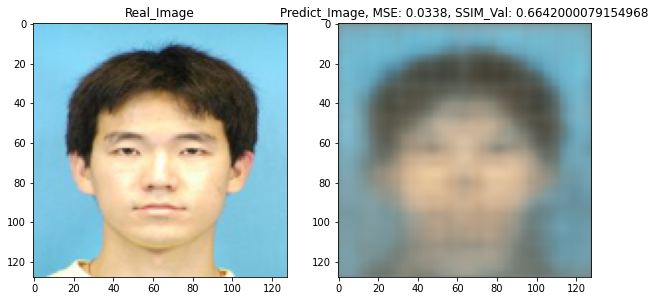

1/1 [==============================] - 0s 21ms/step


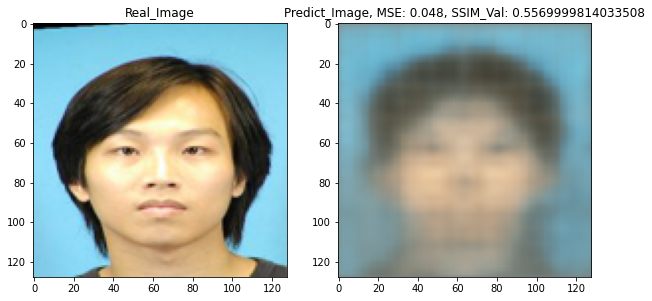

1/1 [==============================] - 0s 22ms/step


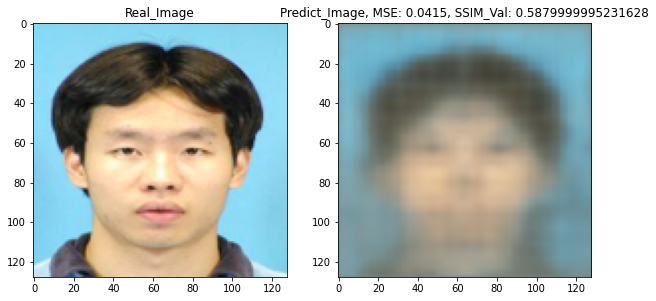

1/1 [==============================] - 0s 23ms/step


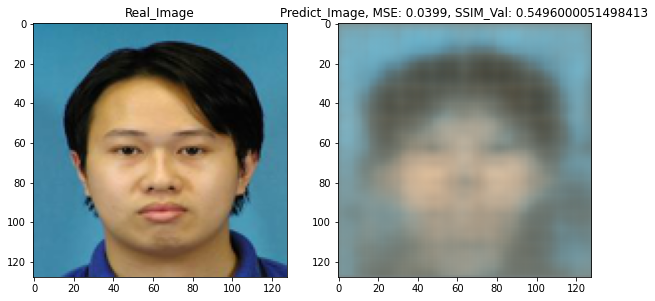

1/1 [==============================] - 0s 22ms/step


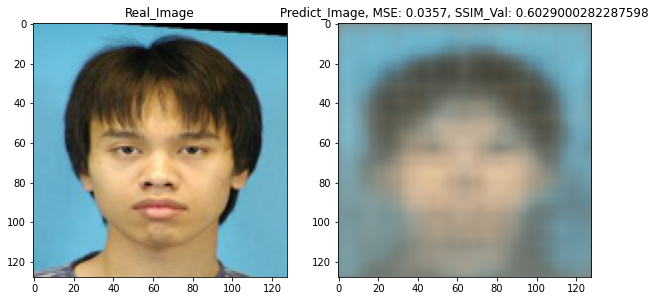

1/1 [==============================] - 0s 22ms/step


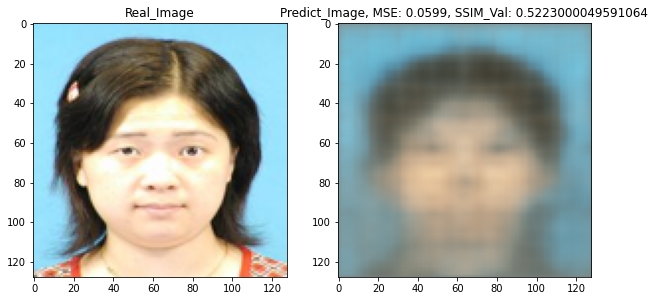

1/1 [==============================] - 0s 29ms/step


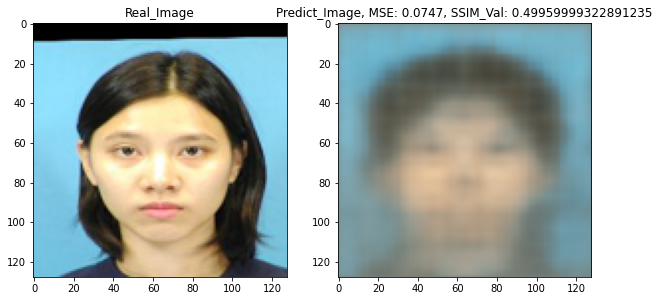

1/1 [==============================] - 0s 22ms/step


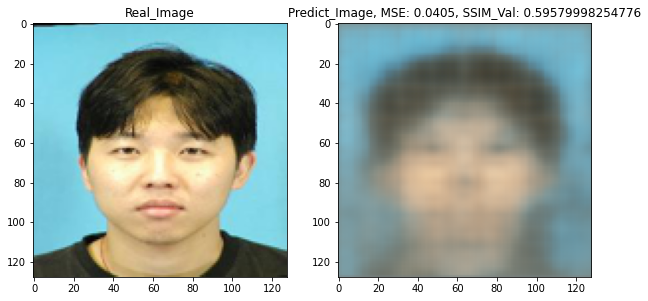

1/1 [==============================] - 0s 30ms/step


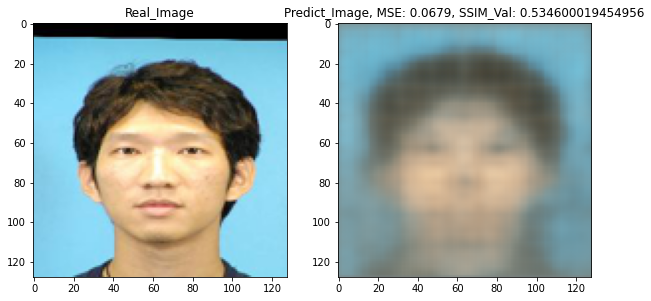

1/1 [==============================] - 0s 30ms/step


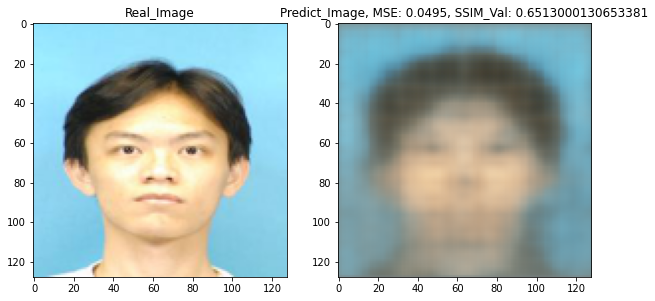

1/1 [==============================] - 0s 22ms/step


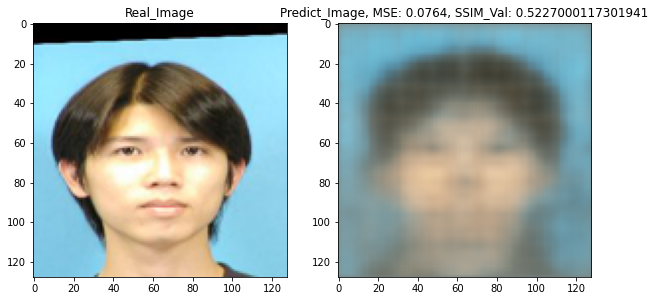

1/1 [==============================] - 0s 21ms/step


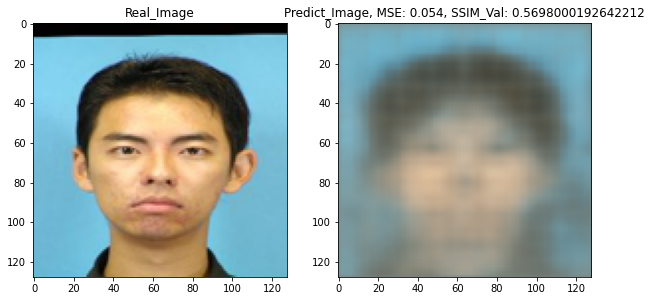

1/1 [==============================] - 0s 21ms/step


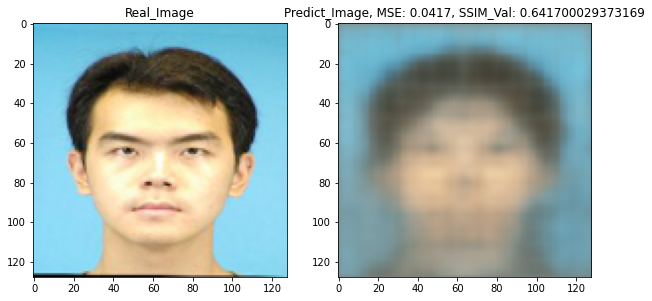

The overall MSE analysis of test dataset: Mean:0.0492, Max:0.0877, Min:0.0243
The overall SSIM_Val analysis of test dataset: Mean:0.5821999907493591, Max:0.6642000079154968, Min:0.4553999900817871


In [32]:
# Store all test cases' evaluations
MSE_all = []
SSIM_val_all = []
# 使用VAE模型生成素描图片
for fileName in os.listdir(filePath3):
    # 读取输入图片
    image_tmp = Image.open(os.path.join(filePath3, fileName))
    
    # 转换为模型的输入格式
    image_tmp = image_tmp.resize((128, 128))
    img_tmp = np.array(image_tmp).reshape((1,128,128,3)).astype('float32') / 255.
    realImage_array = img_tmp.reshape(128,128,3)

    # 使用VAE模型生成素描图片
    sketch_img = vae.predict(img_tmp)
    sketch_img = np.clip(sketch_img, 0.0, 1.0)
    sketch_image = sketch_img.reshape(128,128,3)

    # Calculate MSE and SSIM of predict Image
    evaluations_tmp = imgPredictionEvaluate(realImg_array = realImage_array, predictImg_array = sketch_image)
    mse_tmp = evaluations_tmp[0]
    ssim_val_tmp = evaluations_tmp[1]
    MSE_all.append(mse_tmp)
    SSIM_val_all.append(ssim_val_tmp)
    # 显示生成的素描图片
    plt.figure(figsize = (10,10))
    plt.subplot(1,2,1)
    plt.title('Real_Image')
    plt.imshow(image_tmp, cmap = 'gray')
    plt.subplot(1,2,2)
    name = 'Predict_Image, MSE: {}, SSIM_Val: {}'.format(mse_tmp, ssim_val_tmp)
    plt.title(name)
    plt.imshow(sketch_image, cmap = 'gray')
    plt.show()

# calculate the overall MSE & SSIM
MSE_all_Mean = round(np.mean(MSE_all), 4)
MSE_all_Max = np.max(MSE_all)
MSE_all_Min = np.min(MSE_all)

SSIM_val_all_Mean = round(np.mean(SSIM_val_all), 4)
SSIM_val_all_Max = np.max(SSIM_val_all)
SSIM_val_all_Min = np.min(SSIM_val_all) 

print('The overall MSE analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(MSE_all_Mean, MSE_all_Max, MSE_all_Min))
print('The overall SSIM_Val analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(SSIM_val_all_Mean, SSIM_val_all_Max, SSIM_val_all_Min))


In [ ]:
cp /content/model_79.h5 /content/drive/MyDrive